# Download and Install Textflow

In [ ]:
!git clone https://github.com/sinai-uja/textflow.git

## If you use local notebook

In [ ]:
!(cd textflow; python -m pip install .)
import os
textflowPath = './textflow'
os.chdir(textflowPath)

## If you use Colab Notebook

In [ ]:
%cd textflow
!python -m pip install emoji==1.7.0 lexical_diversity

## Note

Note: In this point is important to restart the virtual enviroment. If you do not restart the enviroment probably get an AttributeError: module 'numpy.linalg._umath_linalg' has no attribute '_ilp64'

## Load the data

In this case, we are going to use the validation set from [OffendES: A New Corpus in Spanish for Offensive Language Research](https://aclanthology.org/2021.ranlp-1.123) (Plaza-del-Arco et al., RANLP 2021)



In [ ]:
import os
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

pathValidationSet = './validation.csv'
dicLabel={0: 'OFP', 1: 'OFG', 2: 'NO', 3: 'NOM'}
df = pd.read_csv(pathValidationSet)
df['label']=[dicLabel[df['label'][i]] for i in df.index]

In [ ]:
df

,comment_id,comment,influencer,influencer_gender,media,label
0,27341,Me encanta el videooo porciento aidii he subid...,dulceida,woman,youtube,NO
1,21310,"Ropa cara?veo dulceida shop, Zara.. y de todas...",lauraescane,woman,youtube,NO
2,23809,Y la perra seguia y seguia.jpg :v,windygirk,woman,youtube,OFP
3,14532,Malditas drogas,wismichu,man,youtube,NO
4,51651,"perdona el spam , es la primera vez que trato ...",dalas,man,instagram,NO
...,...,...,...,...,...,...
95,58740,Me alegra dalas . Soy nuevo seguidor y me aleg...,dalas,man,instagram,NO
96,6796,En resumen Dalas le callo la puta boca.,nauterplay,man,youtube,NOM
97,53415,"Genial!! Que te lleven a Alcaser, a ver las Ca...",soyunapringada,woman,instagram,NO
98,49449,Hola dalas quiero que sepáis que tienes mi tot...,dalas,man,instagram,NO


# Analyzing the data

In [ ]:
import nltk
import re
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer, WordPunctTokenizer
nltk.download('stopwords')
from nltk.stem import WordNetLemmatizer
nltk.download("wordnet")
nltk.download("omw-1.4")

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/mevr0003/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/mevr0003/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/mevr0003/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [ ]:
#Import the analyzers.
from textflow.BDLASEAnalyzer import BDLASEAnalyzer
from textflow.ComplexityAnalyzer import ComplexityAnalyzer
from textflow.EmofinderAnalyzer import EmofinderAnalyzer
from textflow.EmojiAnalyzer import EmojiAnalyzer
from textflow.EmojiPolarityAnalyzer import EmojiPolarityAnalyzer
from textflow.EmoticonsPolarityAnalyzer import EmoticonsPolarityAnalyzer
from textflow.EmotionAnalyzer import EmotionAnalyzer
from textflow.IronyAnalyzer import IronyAnalyzer
from textflow.IsalAnalyzer import IsalAnalyzer
from textflow.LemmaAnalyzer import LemmaAnalyzer
from textflow.LexicalDiversityAnalyzer import LexicalDiversityAnalyzer
from textflow.LiwcAnalyzer import LiwcAnalyzer
from textflow.NcrAnalyzer import NcrAnalyzer
from textflow.NERAnalyzer import NERAnalyzer
from textflow.NGramsAnalyzer import NGramsAnalyzer
from textflow.PerplexityAnalyzer import PerplexityAnalyzer
from textflow.PolarityAnalyzer import PolarityAnalyzer
from textflow.POSAnalyzer import POSAnalyzer
from textflow.SelAnalyzer import SelAnalyzer
from textflow.StylometryAnalyzer import StylometryAnalyzer
from textflow.VolumetryAnalyzer import VolumetryAnalyzer

#Import the sequence string.
from textflow.SequenceString import SequenceString

[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.9/12.9 MB 59.2 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


**Note:** It is important to download the resource that we are going to use in the analyzers.

In the lower code cell the analyzers are defined. These analyzers have many parameters that can be modified as desired. For more information, access the official [documentation](https://github.com/sinai-uja/textflow)

In [ ]:
#Create the analyzers with their parameters.
bdlase = BDLASEAnalyzer()
complexity = ComplexityAnalyzer()
emofinder = EmofinderAnalyzer()
emoji = EmojiAnalyzer()
emojiPolarity = EmojiPolarityAnalyzer(positiveEmojiPath = "./textflow/emojis/emojiPositive.txt", negativeEmojiPath = './/textflow/emojis/emojiNegative.txt')
emoticonsPolarity = EmoticonsPolarityAnalyzer(positiveEmojiPath = ".//textflow/emoti-sp/emoticonsPositive.txt", negativeEmojiPath = './/textflow/emoti-sp/emoticonsNegative.txt')
emotion = EmotionAnalyzer()
ironity = IronyAnalyzer()
isal = IsalAnalyzer()
lemma = LemmaAnalyzer()
lexicalDiversity = LexicalDiversityAnalyzer(lemmatizer=WordNetLemmatizer().lemmatize)
liwc = LiwcAnalyzer()
ncr = NcrAnalyzer()
ner = NERAnalyzer()
n1 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 1)
n2 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 2,stopwords=[])
n3 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 3,stopwords=[])
n4 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 4,stopwords=[])
perplexity = PerplexityAnalyzer(device="cpu")
polarity = PolarityAnalyzer()
pos = POSAnalyzer()
sel = SelAnalyzer()
stylometry = StylometryAnalyzer(stopwords.words('spanish'),tokenizer = WordPunctTokenizer())
volumetry = VolumetryAnalyzer()

#Create our list of sequences.
## In this case, we are going to use Sequence from String using our text column in the DataFrame.
## Althought there are more types of Sequences and you can create your own Sequence. For more information about Sequence go to https://github.com/sinai-uja/textflow?tab=readme-ov-file#how-to-create-a-sequence
listSequence = []
for index, row in df.iterrows():
  s = SequenceString(row["comment"])
  listSequence.append(s)

Xformers is not installed correctly. If you want to use memory_efficient_attention to accelerate training use the following command to install Xformers
pip install xformers.


In [ ]:
#Analyze each sequence of our list of sequences. Each analyzer function receives:
  #  sequence: the Sequence we want to analyze.
  #  tag: the label to store the analysis result.
  #  levelOfAnalyzer: the path of the sequence level to analyze inside of the result.
  #  levelOfResult: [OPTIONAL] the path of the sequence level to store the result.

for s in listSequence:
  bdlase.analyze(s,"bdlase","text")
  complexity.analyze(s,"complexity","text")
  emofinder.analyze(s,"emofinder","text")
  emoji.analyze(s,"emoji","text")
  emojiPolarity.analyze(s,"emojiPolarity","text")
  emoticonsPolarity.analyze(s,"emoticons","text")
  emotion.analyze(s,"emotion","text")
  ironity.analyze(s,"ironity","text")
  isal.analyze(s,"isal","text")
  lemma.analyze(s,"lemmas","text")
  lexicalDiversity.analyze(s,"lexicalDiversity","text")
  liwc.analyze(s,"liwc","text")
  ncr.analyze(s,"ncr","text")
  ner.analyze(s,"NER","text")
  n1.analyze(s,"1-grams","text")
  n2.analyze(s,"2-grams","text")
  n3.analyze(s,"3-grams","text")
  n4.analyze(s,"4-grams","text")
  perplexity.analyze(s,"perplexity","text")
  polarity.analyze(s,"polarity","text")
  pos.analyze(s,"POS","text")
  sel.analyze(s,"sel","text")
  stylometry.analyze(s,"stylometry","text")
  volumetry.analyze(s,"volumetry","text")

  0%|          | 0/1 [00:00<?, ?it/s]


In [ ]:
# In order to know more about a sequence, the Sequence structure is shown below:
s

Sequence(
  format: string
  metadata: {'text': 'Por que crees que hablan mal de ti 1 haces mucha polemica 2 muestras mucho tu escote y ya nos cansamos 3 casi la mitad de tus subs son haters También pones títulos con doble sentido Y aún hay más', 'bdlase': [[[0.0, 0.0, 0.6666666666666666, 0.3333333333333333], [0.0, 0.0, 0.6666666666666666, 0.3333333333333333], [0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.6666666666666666, 0.3333333333333333]]], 'complexity': [{'nSentences': 2, 'nComplexSentence': 0, 'avglenSentence': 20.0, 'nPuntuationMarks': 0, 'nWords': 40, 'nRareWords': 11, 'nSyllabes': 61, 'nChar': 3, 'ILFW': 0.42857142857142855, 'LDI': 7.0, 'LC': 3.7142857142857144, 'SSR': 145.425, 'SCI': 10.0, 'ARI': 10.35325, 'huerta': 185.525, 'IFSZ': 91.82750000000001, 'polini': 51.097500000000004, 'mu': 99.20007956579805, 'minage': 7.7268574999999995, 'SOL': 6.489691271489054, 'crawford': 3.0404999999999998, 'min_depth': 1, 'max_depth': 8, 'mean_depth': 4.5}], 'emofinder': [[[0.0, 0.0, 0.0, 0.0], [0.0,

Using the next cells of code we are going to create a DataFrame with the results of the analyzers.

In [ ]:
# Calculation of all POS tags that are present in our sequences.
## To do that, we move to the level where the results of the POS analyzer are saved
## and create a set with all the tags.
POStags = set()
for seq in listSequence:
  for tag in seq.metadata['POS'][0]['FreqPOS']:
    POStags.add(tag)

In [ ]:
# We need to define a list with all the analyzer labels.
labels = ["bdlase","complexity","emofinder","emoji","emojiPolarity","emoticons","emotion","ironity","isal","lemmas","lexicalDiversity","liwc","ncr","NER","1-grams","2-grams","3-grams","4-grams","perplexity","polarity","POS","sel","stylometry","volumetry"]

# Creation of a dictionary that will save all the information of the sequences, this dictionary will have as
# keys the analyzer labels + analyzer metric and as value for each key, a list with the values obtained by
# analyzing the sequences contained in listSequence.
dicTotal = {}
for seq in listSequence:
  for l in seq.metadata:
    if l in labels:
      if l in ["polarity", "emotion", "ironity"]:
        for category in seq.metadata[l][0][0]:
          l_key = str(l+category['label'])
          dicTotal[l_key] = dicTotal.get(l_key, []) + [category['score']]
      elif l == 'POS':
        for cat in ['FreqPOS', 'RelFreqPOS']:
          for tag in POStags:
            dicTotal[cat+''+tag] = dicTotal.get(cat+''+tag, []) + [seq.metadata[l][0][cat].get(tag, 0)]
        l_key = str(l)+'POSTokens'
        dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0]['POSTokens']]
      elif l == 'perplexity':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      elif l == 'bdlase' or l == 'emofinder' or  l=='isal'or l == 'liwc' or l=='ncr' or l=='sel':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      else:
        for key in seq.metadata[l][0]:
          l_key = str(l+key)
          dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0][key]]

# Once we have a dictionary with all the information of the sequences, the DataFrame can be created.
for k in dicTotal:
  df[str(k)] = dicTotal[k]

# We show the columns of the DataFrame.
print(df.columns.to_list())

# Save the DataFrame as csv File.
df.to_csv('/home/mevr0003/proyectos/textflow/Examples/df_with_textflow_analysis.csv', index='False')

['comment_id', 'comment', 'influencer', 'influencer_gender', 'media', 'label', 'bdlase', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emofinder', 'emojiTextWithoutEmoji', 'emojiFreqEmoji', 'emojiNumEmojis', 'emojiPolaritynumEmojisPolarity', 'emojiPolaritypercentageEmojisPolarity', 'emojiPolaritydistinctEmojiFounded', 'emoticonsnumTextEmojisPolarity', 'emoticonspercentageTextEmojiPolarity', 'emoticonsdistinctTextEmojiFounded', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionf

# Results of Data Analysis

In [ ]:
# Import the Test and Visualization Modules of TextFlow.
import os
import pandas as pd
from textflow.Test import Test
from textflow.Visualization import Visualization

In [ ]:
# Read the DataFrame with all the results of the text analysis for each sequence.
df = pd.read_csv('./Examples/df_with_textflow_analysis.csv')

# If we load the DataFrame from csv, some dictionaries, lists and other types of object are of string type,
# so we need to use the eval function in order to convert them to their original nature.
df['1-gramsfreqN-Grams']=df['1-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['2-gramsfreqN-Grams']=df['2-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['3-gramsfreqN-Grams']=df['3-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['4-gramsfreqN-Grams']=df['4-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['POSPOSTokens']=df['POSPOSTokens'].apply(lambda x: eval(x))

## Most Frequent Words, N-grams and POS words

In [ ]:
# Create the visualization object.
# It receives:
## savePath: an string with the path where different graphics will be saved. By default savePath= '.'
## n_cols: the number of columns of the subplot grid. By default n_cols=6.
## cmap: a colormap that is applied to the images. By default cmap=sns.diverging_palette(230, 20, as_cmap=True).
visualizer = Visualization()

### WordClouds


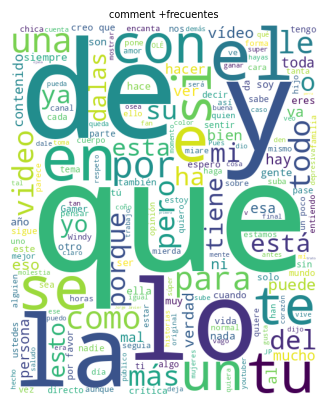

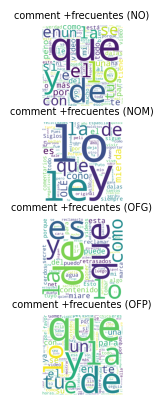

In [ ]:
# We use the wordCloud function of the visualizer to show the most frequent words.
## All of the dataset (without groupby).
visualizer.show_wordCloud(df,['comment'])
## For each label of the dataset (Grouping the DF by 'label' column).
visualizer.show_wordCloud(df,['comment'],groupby='label')

### N-Gramas

<Figure size 640x480 with 0 Axes>

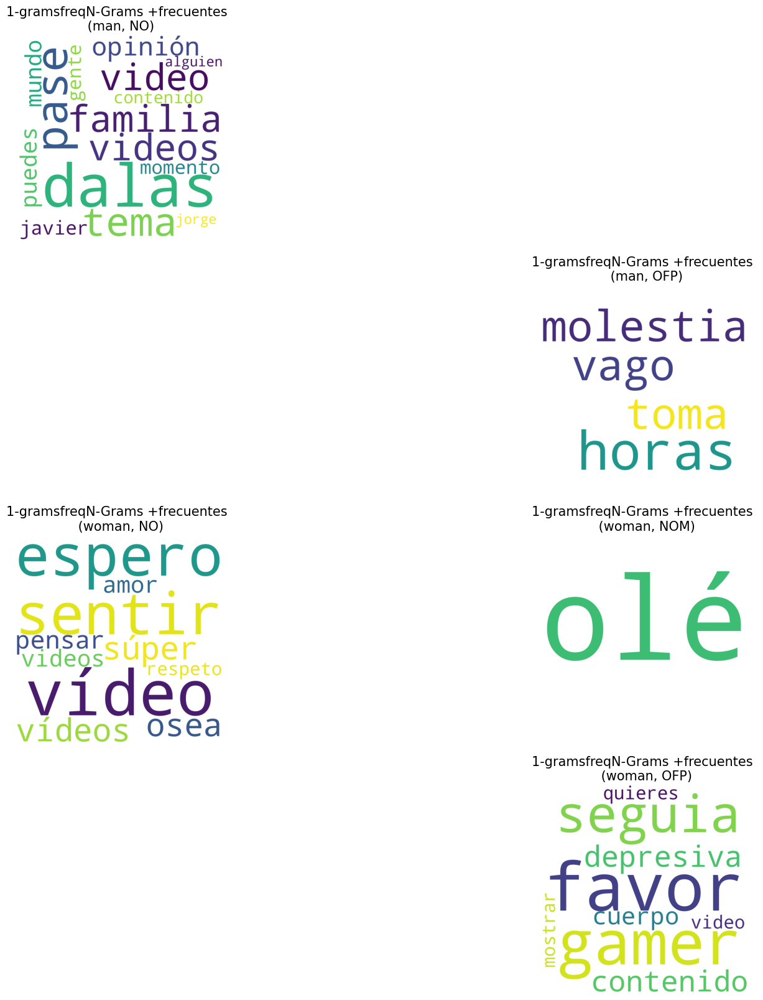

<Figure size 640x480 with 0 Axes>

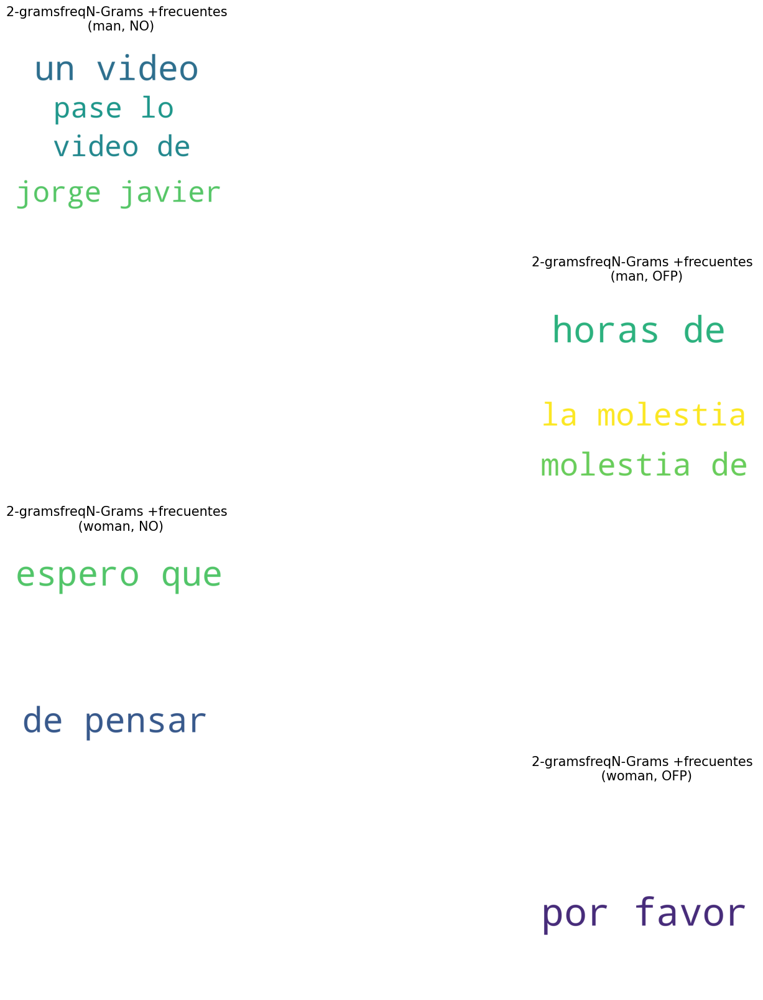

<Figure size 640x480 with 0 Axes>

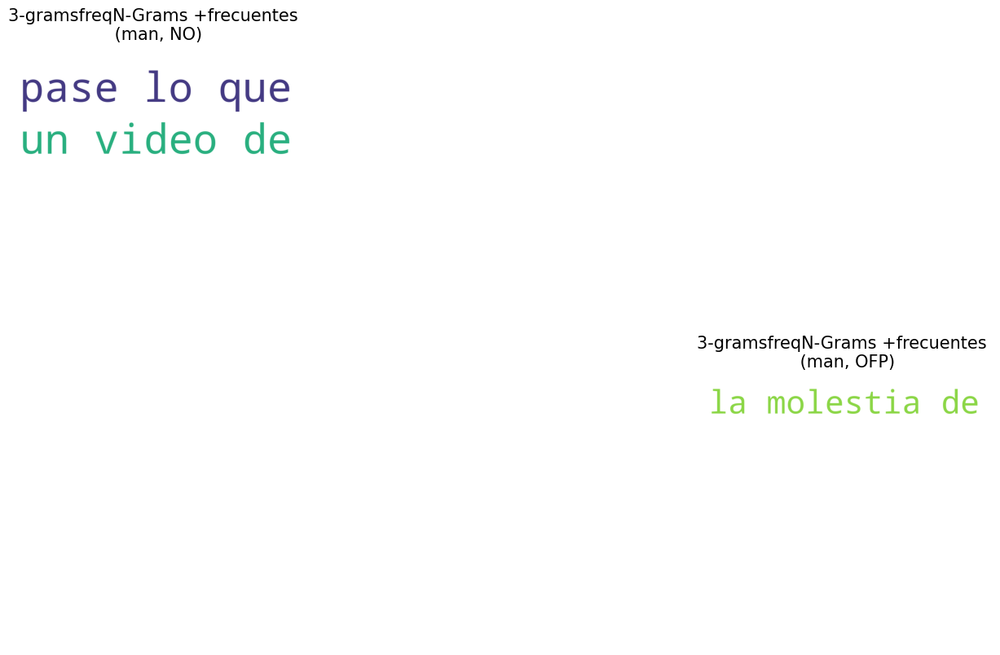

<Figure size 640x480 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

In [ ]:
# Import the collection of spanish stopwords from spaCy.
from spacy.lang.es.stop_words import STOP_WORDS

# Create a new DataFrame
new_df = pd.DataFrame()
# For each n-gram calculated with the analyzers (In this examples we have 1 to 4 n-grams).
for ngramas in [str(n+1)+"-gramsfreqN-Grams" for n in range(4)]:
    # We group the DataFrame by the columns 'influencer_gender' and 'label' using an aggregation function that will create a dictionary that contains:
    ## the sum of the occurrences for each unique element of all lists in the n-gram column grouped by 'influencer_gender' and 'label'.
    ## This dictionary is sorted in descending order.
    newdf = df.groupby(['influencer_gender', 'label'])[ngramas].agg(lambda x: dict(sorted({k: sum(d.get(k, 0) for d in x) for k in set().union(*x)}.items(), key=lambda item:item[1], reverse=True))).reset_index()
    # Create an empty list to store the ngram dictionaries.
    ngramsArray=[]
    # Iterate over the rows of the newly created dataframe.
    for i in newdf.index:
        # Copy the ngram dictionary of each row of the newdf.
        ngramsDict= newdf[ngramas][i].copy()
        # Check that the n-grams of the dictionary do not contain empty words and have more than 3 letters.
        for k in newdf[ngramas][i]:
            valid = False
            for e in k.split(' '):
                if e not in STOP_WORDS and len(e) > 1:
                    valid = True
                    break
            if not valid or ngramsDict[k] < 3:
                del ngramsDict[k]
        ngramsArray.append(ngramsDict)
    # Modify the columns of new_df with the information selected in the previous process to display the word cloud.
    new_df[ngramas], new_df['Sexo'], new_df['label'] = ngramsArray, newdf['influencer_gender'], newdf['label']
# Display the word cloud according to the gender of the person and the offensiveness tag.
visualizer.show_wordCloud(new_df,[str(n+1)+"-gramsfreqN-Grams" for n in range(4)], widthGraphic = 20,heightGraphic=20,hspace= 0.25,titleGraphicSize= 15,groupby=['Sexo','label'])

### POS

<Figure size 640x480 with 0 Axes>

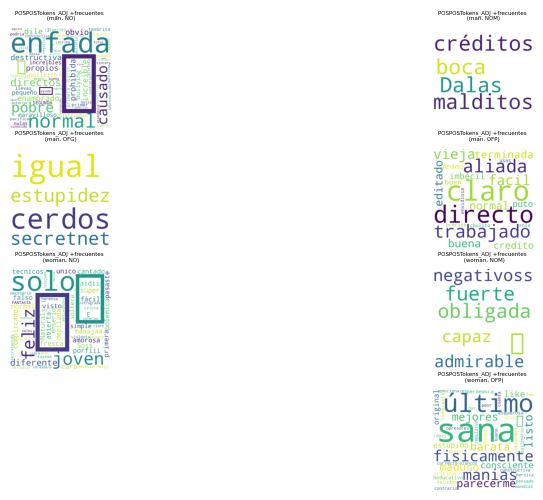

<Figure size 640x480 with 0 Axes>

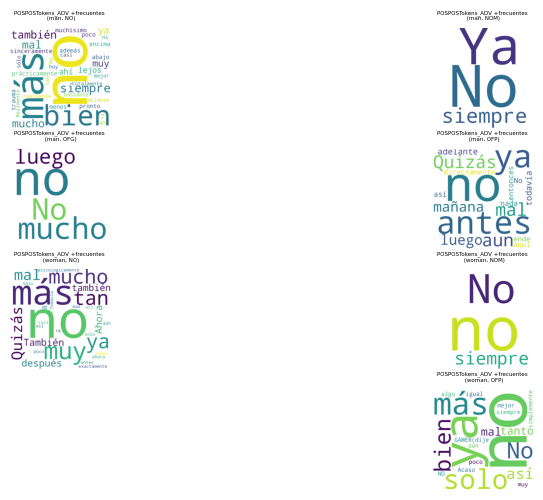

<Figure size 640x480 with 0 Axes>

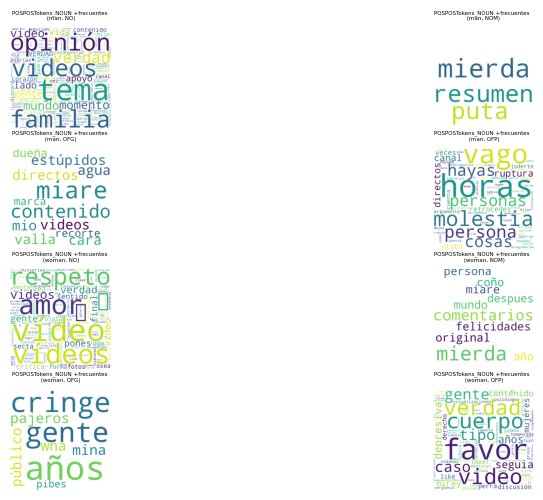

<Figure size 640x480 with 0 Axes>

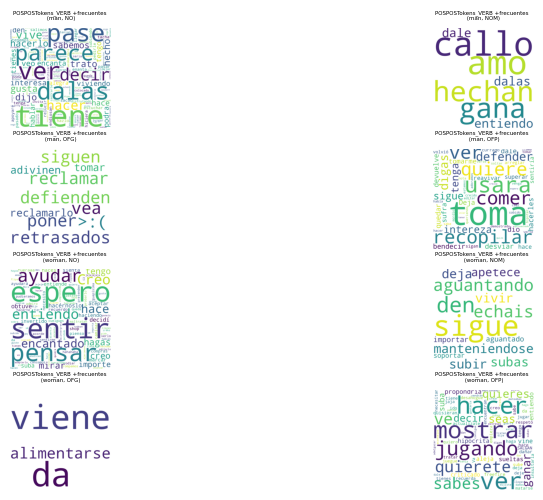

In [ ]:
# Define a list of POS tags from which we want to obtain a word cloud.
POS_LIST = ["ADJ", "ADV", "NOUN", "VERB"]

# Initialize new_df as an empty DataFrame.
new_df = pd.DataFrame()
# Initialize the boolean variable first to true. This variable will represent if it is the first iteration of our loop.
first=True
# For each item in the POS tag list:
for pos in POS_LIST:
    # Create a new column in the 'df' DataFrame, whose name is defined by 'POSPOSTokens' and the value of the variable pos.
    ## The values in this column will be the values associated with the pos key in the dictionary stored in the 'POSPOSTokens' column for each row of the DataFrame.
    ## If the pos key is not present in the dictionary, an empty dictionary {} will be assigned.
    df['POSPOSTokens'+"_"+pos] = [df['POSPOSTokens'][i].get(pos, {}) for i in df.index]
    # Create a new DataFrame named newdf that will save the results of the agrupation of df by the columns 'influencer_gender' and 'label'. The aggregation function used to group these two columns.
    # consist in the creation of a dictionary that calculates the occurrences of the pos elements in the 'POSPOSTokens' columns, sorted by value in descending order.
    newdf = df.groupby(['influencer_gender', 'label'])['POSPOSTokens_'+pos].agg(lambda x: dict(sorted({k: sum(d.get(k, 0) for d in x) for k in set().union(*x)}.items(), key=lambda item:item[1], reverse=True))).reset_index()
    # If it is not the first iteration , we remove the columns 'influencer_gender' and 'label' of the newdf DataFrame.
    newdf = newdf.drop(['influencer_gender', 'label'], axis=1) if first==False else newdf
    # Establish the value of the boolean variable to False.
    first = False
    # Join the two DataFrames(new_df and newdf).
    new_df = pd.concat([new_df, newdf], axis=1)
# Display the word cloud according to the gender of the person and the offensiveness tag.
visualizer.show_wordCloud(new_df,['POSPOSTokens'+"_"+pos for pos in POS_LIST], hspace= 1.2,titleGraphicSize= 4,groupby=['influencer_gender','label'])

## Normality and significance Tests

### Tests with visualization graphics

---------------------------------------NORMALITY TEST---------------------------------------
Columnas 95
Pass the test of Shapiro
['complexitySSR', 'lexicalDiversityRootTTR', 'stylometryDugast']
Pass the test of D'Agostino
['complexityILFW', 'complexitySSR', 'lemmasavgLemmas', 'lexicalDiversityRootTTR', 'RelFreqPOSPRON', 'RelFreqPOSVERB', 'RelFreqPOSDET', 'stylometryDugast']
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 15.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 10.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 5.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 2.5 level of significance
Pass the test of Anderson-Darling
['comp

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexityILFW,Hombre,Mujer,1126.0,0.395599,-0.607666,0.546273,0.349141,0.555960
1,emotionothers,Hombre,Mujer,1535.0,0.049399,1.561050,0.125082,3.254372,0.074305
2,ironityNI,Hombre,Mujer,1203.0,0.751108,1.013443,0.315930,1.006250,0.318273
3,complexitynChar,Hombre,Mujer,1217.5,0.826474,-0.482126,0.631908,0.233411,0.630084
4,RelFreqPOSSYM,Hombre,Mujer,1200.5,0.167903,-1.420703,0.161867,1.936858,0.167161
5,polarityNEG,Hombre,Mujer,1205.0,0.761594,-0.423471,0.673843,0.207052,0.650094
6,lexicalDiversityRootTTR,Hombre,Mujer,1049.5,0.168947,-1.639844,0.107576,2.769195,0.099289
7,lexicalDiversityMTLD,Hombre,Mujer,1309.0,0.684143,0.961761,0.340990,0.945534,0.333253
8,RelFreqPOSINTJ,Hombre,Mujer,1327.0,0.159782,1.072941,0.288662,1.206685,0.274681
9,emotiondisgust,Hombre,Mujer,1015.0,0.106641,-1.305573,0.197921,1.511260,0.221890


Se han truncado las últimas 5000 líneas del flujo de salida.
7          0.602599  
8          0.823765  
9          0.393681  
10         0.435515  
11         0.444000  
12         0.286732  
13         0.403957  
14         0.155484  
15         0.415854  
16         0.127548  
17         0.049398  
18         0.681612  
19         0.178765  
20         0.361141  
21         0.548583  
22         0.633402  
23         0.278442  
24         0.313659  
25         0.618908  
26         0.049001  
27         0.016571  
28         0.696848  
29         0.119978  
30         0.152501  
31         0.105895  
32         0.446108  
33         0.748493  
34         0.748493  
35         0.571540  
36         0.540542  
['lexicalDiversityRootTTR', 'Hombre', 'Mujer', 1049.5, 0.16894664098199552]
['lexicalDiversityRootTTR', 'Hombre', 'Mujer', 1049.5, 0.16894664098199552, 459.0, 0.12884437305203988, 1.9017622110440853, 0.16788120413196195]
                       Feature Criteria_1 Criteria_2  mann

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,Hombre,Mujer,1377.0,0.381198,498.0,0.259326,0.772883,0.379327
1,complexitynSentences,Hombre,Mujer,1137.0,0.402759,232.5,0.549671,0.706340,0.400662
2,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,110.0,0.347515,0.551709,0.457620
3,complexityavglenSentence,Hombre,Mujer,1368.0,0.415744,462.0,0.196236,0.667938,0.413771
4,complexitynPuntuationMarks,Hombre,Mujer,1372.5,0.392535,472.5,0.791935,0.737056,0.390606
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,Hombre,Mujer,1125.5,0.394419,465.0,0.144754,0.731160,0.392507
91,volumetrywords,Hombre,Mujer,1332.5,0.569346,504.0,0.388857,0.327714,0.567008
92,volumetryuniqueWords,Hombre,Mujer,1343.5,0.518923,486.0,0.408999,0.420495,0.516690
93,volumetrychars,Hombre,Mujer,1330.0,0.581196,509.5,0.420737,0.308121,0.578835


{'mannwhitneyu': {'Reject H0': ['complexitypolini', 'emotionothers', 'emotionjoy', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'l

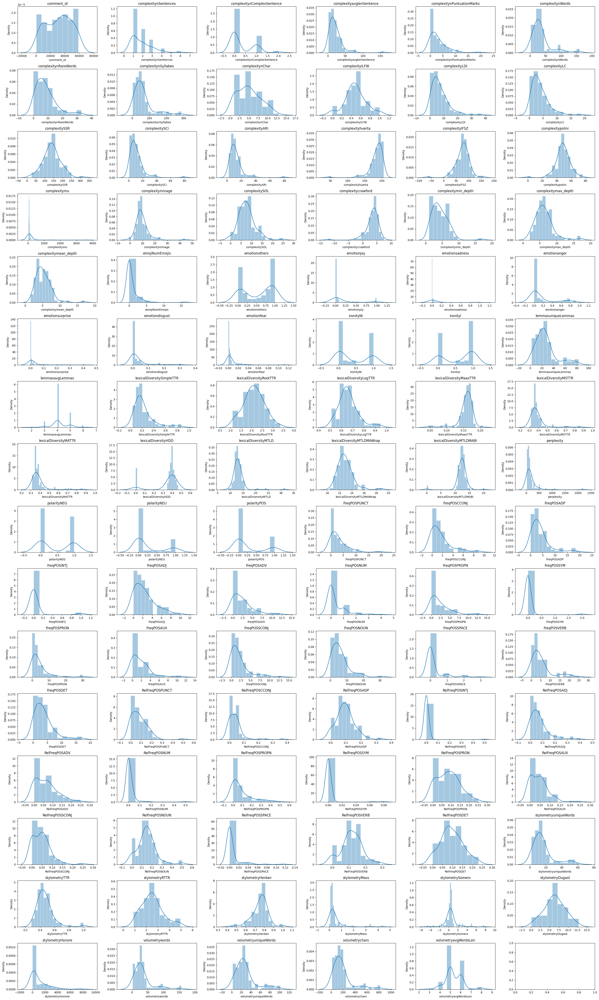

---------------------------------------PROBPLOT GRAPHICS---------------------------------------


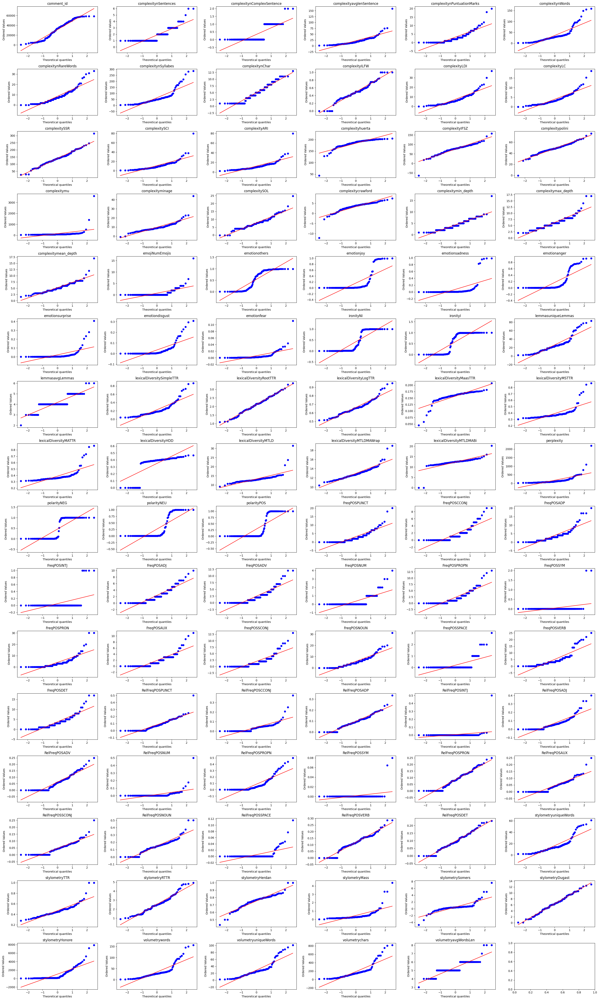

---------------------------------------KDE GRAPHICS---------------------------------------


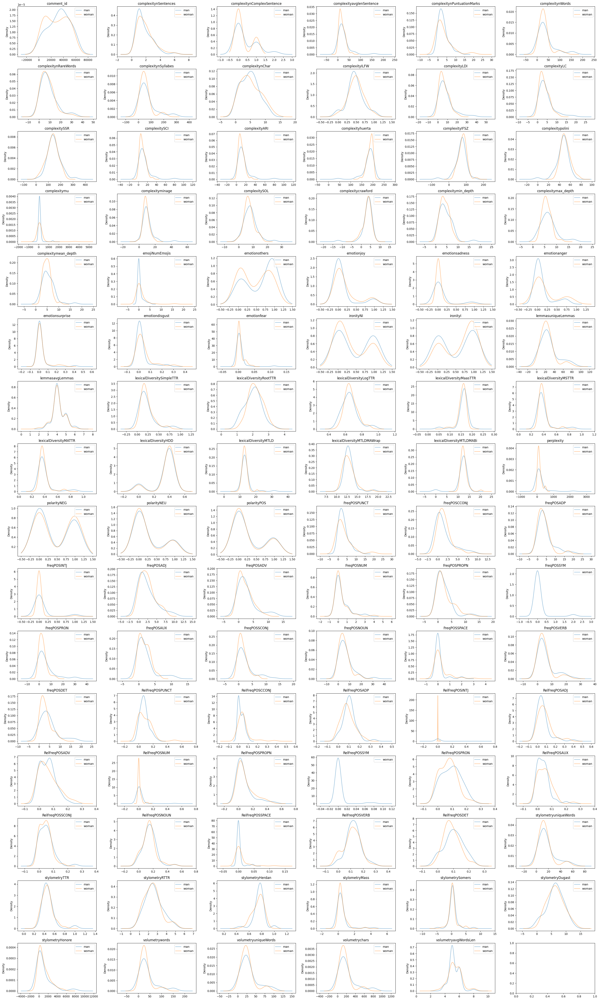

---------------------------------------BOXPLOT GRAPHICS---------------------------------------


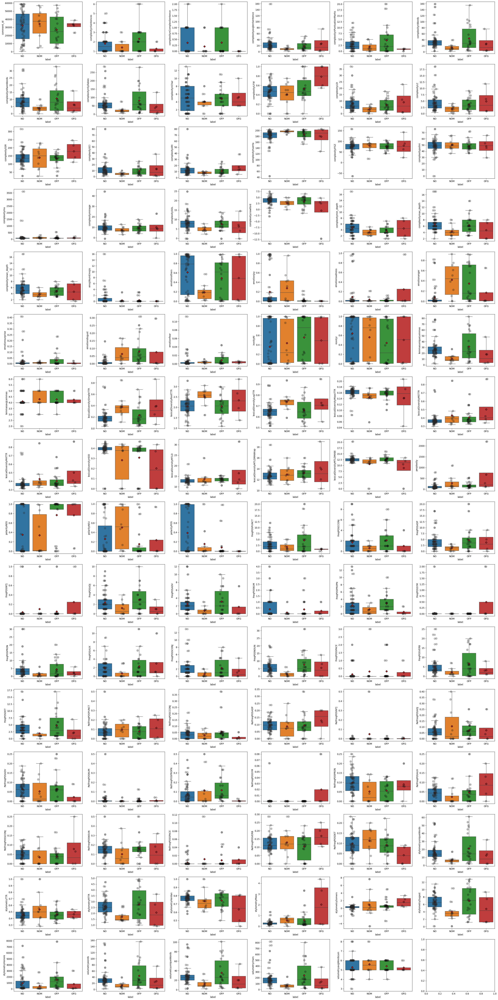

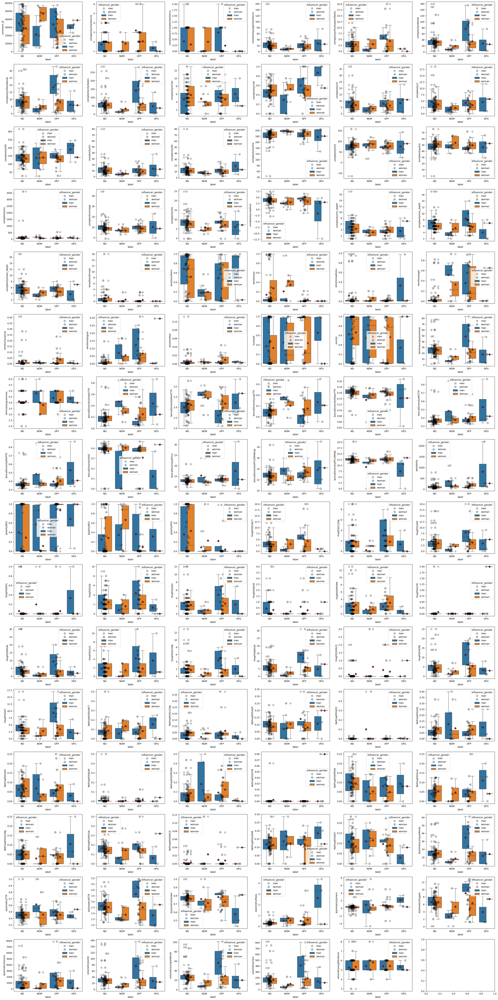

In [ ]:
# Create an object of the test class. This function contains the following parameters:
## normalityTest: a list with the normality tests to apply. Possibles values: ["Shapiro","D'Agostino","Anderson-Darling","Chi-Square","Lilliefors","Jarque–Bera","Kolmogorov-Smirnov"].
## parametricTest: a list with the parametric tests to apply. Possibles values: ["Students t-test","Paired Students t-Test", "ANOVA"].
## nonParametricTest: a list with the non parametric tests to apply. Posibles values: ["mannwhitneyu","wilcoxon","kruskal"].
## alpha: chosen significance level to interpret the p-value in parametric/non parametric tests. Posibles values: float between 0 and 1.
t=Test() # By default: normalityTest=["Shapiro","D'Agostino","Anderson-Darling","Chi-Square","Lilliefors","Jarque–Bera","Kolmogorov-Smirnov"], parametricTest=["Students t-test","Paired Students t-Test", "ANOVA"], nonParametricTest=["mannwhitneyu","wilcoxon","kruskal"],alpha=0.05

# Create a list to store those columns of the dataframe that are numeric.
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
# Create the Visualization Object to print the different graphs associated with the test class.
v=Visualization()

# With the following line:
## Some stadistical tests are calculated: normality tests and significant tests (parametrics and non-parametric).
## Some plots are visualized (DISTPLOT, PROBPLOT, KDE and BOXPLOT).
testResults=t.report(df[df['influencer_gender']=="man"],df[df['influencer_gender']=="woman"],"Hombre","Mujer",v,'influencer_gender',['label','label'],[None,'influencer_gender'])

In [ ]:
# The function that calculates all these tests returns a dictionary that has 3 keys: the different types of tests that it applies.
# These keys contain the results of applying the tests, returned in a tuple (results dataframe, list of characteristics that pass the test).
testResults.keys()

dict_keys(['normalTest', 'parametricTest', 'nonParametricTest'])

In [ ]:
# For each key of the dictionary, a DataFrame is returned with the stadistic value and the p-value of each test applied and as rows the feature on which the test is being applied.
print(testResults['normalTest'][0])
# A dictionary that has as key, the applied test and as value, a list of metrics that pass the tests.
print(testResults['normalTest'][1])

                            Shapiro stat  Shapiro p-value  D'Agostino stat  \
Unnamed: 0                      0.954725     1.721887e-03        34.673556   
comment_id                      0.943080     2.986405e-04        36.715430   
label                           0.723401     1.961459e-12        11.002115   
complexitynSentences            0.756587     1.403096e-11        36.226106   
complexitynComplexSentence      0.615949     8.734215e-15        23.645830   
...                                  ...              ...              ...   
stylometryHonore                0.683087     2.214561e-13        63.723534   
volumetrywords                  0.753795     1.180914e-11        53.975317   
volumetryuniqueWords            0.828557     2.065794e-09        35.835871   
volumetrychars                  0.761839     1.947611e-11        52.300309   
volumetryavgWordsLen            0.820888     1.143945e-09        14.969375   

                            D'Agostino p-value  Anderson-Darlin

### Tests without visualization graphics

In [ ]:
# Example of applying a test report (calculating normality tests, and significant tests) without including graphs.
t=Test()
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
testResults=t.report(df[df['influencer_gender']=="man"],df[df['influencer_gender']=="woman"],"Hombre","Mujer")

---------------------------------------NORMALITY TEST---------------------------------------
Columnas 96
Pass the test of Shapiro
['complexitySSR', 'lexicalDiversityRootTTR', 'stylometryDugast']
Pass the test of D'Agostino
['complexityILFW', 'complexitySSR', 'lemmasavgLemmas', 'lexicalDiversityRootTTR', 'RelFreqPOSVERB', 'RelFreqPOSDET', 'RelFreqPOSPRON', 'stylometryDugast']
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 15.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 10.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 5.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 2.5 level of significance
Pass the test of Anderson-Darling
['comp

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,Hombre,Mujer,1301.5,0.635431,0.982589,0.330737,0.749559,0.388730
1,lexicalDiversityMTLD,Hombre,Mujer,1309.0,0.684143,0.961761,0.340990,0.945534,0.333253
2,polarityNEG,Hombre,Mujer,1205.0,0.761594,-0.423471,0.673843,0.207052,0.650094
3,complexityILFW,Hombre,Mujer,1126.0,0.395599,-0.607666,0.546273,0.349141,0.555960
4,stylometryTTR,Hombre,Mujer,1303.0,0.714554,0.721219,0.474273,0.483568,0.488456
5,lexicalDiversityMTLDMAWrap,Hombre,Mujer,1336.0,0.553190,0.229130,0.819741,0.055940,0.813525
6,complexitySSR,Hombre,Mujer,1404.0,0.288295,1.481741,0.144945,2.014467,0.158979
7,lexicalDiversityLogTTR,Hombre,Mujer,1099.5,0.302618,-0.737503,0.464407,0.552770,0.458967
8,stylometryDugast,Hombre,Mujer,1256.0,0.966999,-0.171150,0.864825,0.039803,0.842281
9,RelFreqPOSADV,Hombre,Mujer,1255.0,0.972190,-0.434674,0.665747,0.234841,0.629038


{'Students t-test': {'Reject H0': ['RelFreqPOSCCONJ', 'emotionothers', 'emotionjoy'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'lexicalDiversityMTLD', 'polarityNEG', 'complexityILFW', 'stylometryTTR', 'lexicalDiversityMTLDMAWrap', 'complexitySSR', 'lexicalDiversityLogTTR', 'stylometryDugast', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'complexitynChar', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'lexicalDiversityRootTTR', 'emotionsadness', 'RelFreqPOSPRON', 'emotiondisgust', 'complexitymax_depth', 'stylometryHerdan', 'RelFreqPOSADP', 'complexitynSentences', 'polarityNEU', 'RelFreqPOSSYM', 'complexitynComplexSentence', 'lexicalDiversityMSTTR', 'lexicalDiversityMaasTTR', 'RelFreqPOSINTJ', 'lexicalDiversityMTLDMABi', 'RelFreqPOSADJ', 'emotionfear', 'RelFreqPOSSPACE', 'stylometryMass', 'polarityPOS', 'lexicalDiversityMATTR', 'lemmasavgLemmas', 'ironityI', 'Unnamed: 0', 'comment_id', 'RelFreqPOSSCONJ', 'ironityNI', 'lexicalDiversitySimpleTTR', 

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,Hombre,Mujer,1255.0,0.972498,282.5,0.000778,0.001438,0.969749
1,comment_id,Hombre,Mujer,1377.0,0.381198,498.0,0.259326,0.772883,0.379327
2,complexitynSentences,Hombre,Mujer,1137.0,0.402759,232.5,0.549671,0.706340,0.400662
3,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,110.0,0.347515,0.551709,0.457620
4,complexityavglenSentence,Hombre,Mujer,1368.0,0.415744,462.0,0.196236,0.667938,0.413771
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,Hombre,Mujer,1125.5,0.394419,465.0,0.144754,0.731160,0.392507
92,volumetrywords,Hombre,Mujer,1332.5,0.569346,504.0,0.388857,0.327714,0.567008
93,volumetryuniqueWords,Hombre,Mujer,1343.5,0.518923,486.0,0.408999,0.420495,0.516690
94,volumetrychars,Hombre,Mujer,1330.0,0.581196,509.5,0.420737,0.308121,0.578835


{'mannwhitneyu': {'Reject H0': ['complexitypolini', 'emotionothers', 'emotionjoy', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDive

### Tests comparing each offensive label according to gender

When we want to take into account two different tag values for the same columns, the value of the column is not included in the DataFrame with the categories to compare. For this reason, we need to add these values to the generated DataFrame at the Test function. In this example, we want to compare the offensive labels features taking into account the influencer_gender

In [ ]:
# Create a dictionary with all the possible values of the influencer_gender and labels that we want to take into account.
categories = {'influencer_gender': ['man','woman'],
              'label':['OFP', 'OFG', 'NO', 'NOM']}
# Create the Test Object
t1=Test()

In [ ]:
# Initialize two emptyDataFrames that will save the finalResults of applying parametric and non-parametric Tests.
dfFinal_noparam=pd.DataFrame()
dfFinal_param=pd.DataFrame()

# Create two empty list that will save the gender values associated to each row of the parametric and non-parametric tests DataFrame.
genderArrayParametric = []
genderArrayNonParametric = []

# For each gender value in categories['influencer_gender'].
for gender in categories['influencer_gender']:
  # For each pair of labels (ci, cj) in the nested loops:
  for ci in range(len(categories['label'])):
    for cj in range(ci+1, len(categories['label'])):
      # Subsets of data dist_i and dist_j are selected from DataFrame df:
      ## dist_i contains the rows where the gender is equal to the current gender of the outer loop and the label is equal to categories['label'][ci].
      ## dist_j contains the rows where the genre is equal to the current genre of the outer loop and the label is equal to categories['label'][cj]. The value of cj is between ci+1 to len(categories['label']).
      dist_i = df[   (df['influencer_gender'] == gender) &
                      (df['label'] == categories['label'][ci])
                ]
      dist_j = df[   (df['influencer_gender'] == gender) &
                      (df['label'] == categories['label'][cj])
                ]
      print('############################')
      print(gender, categories['label'][ci], categories['label'][cj])
      print('############################')
      # If the length of dist_i and dist_j is greater than or equal to 1, a statistical test is performed using the report function of the t1 object.
      ## This function returns a result that includes two DataFrames: tr1_noparam for the non-parametric test and tr1_param for the parametric test.
      if len(dist_i) >= 1 and len(dist_j) >= 1:
        testResult1 = t1.report(dist_i,dist_j,categories['label'][ci],categories['label'][cj])
        tr1_noparam = testResult1['nonParametricTest'][0] # DataFrame of non-parametric tests
        tr1_param = testResult1['parametricTest'][0] # DataFrame of parametric tests
        # The genderArrayNonParametric list is updated by adding the current repeated gender as many times as there are rows in tr1_noparam.
        if len(genderArrayNonParametric) == 0:
          genderArrayNonParametric = [gender for i in range(len(tr1_noparam))]
        else:
          genderArrayNonParametric.extend([gender for i in range(len(tr1_noparam))])
        # The genderArrayParametric list is updated by adding the current repeated gender as many times as there are rows in tr1_param.
        if len(genderArrayParametric) == 0:
          genderArrayParametric = [gender for i in range(len(tr1_param))]
        else:
          genderArrayParametric.extend([gender for i in range(len(tr1_param))])

        # The DataFrames tr1_noparam and tr1_param are concatenated to the DataFrames dfFinal_noparam and dfFinal_param respectively.
        dfFinal_noparam = pd.concat([dfFinal_noparam, tr1_noparam],axis=0)
        dfFinal_param = pd.concat([dfFinal_param, tr1_param],axis=0)

# An 'influencer_gender' column is added to dfFinal_noparam and dfFinal_param with the values of the genderArrayNonParametric and genderArrayParametric lists respectively,
## and the indexes of the DataFrames are reset.
dfFinal_noparam['influencer_gender'] = genderArrayNonParametric
dfFinal_noparam.reset_index(drop=True, inplace=True)

dfFinal_param['influencer_gender'] = genderArrayParametric
dfFinal_param.reset_index(drop=True, inplace=True)

man
OFP
    comment_id                                            comment  influencer  \
40       16986  La chica claro que toma videos que no son de e...  nauterplay   
42       34595  Esa vieja no le intereza arreglar las cosas, y...       dalas   
73        4713  Wismichu usara la cortina de la abuela como ca...    wismichu   
76       53468  Vergüenza sentiría de defender lo que has demo...       dalas   
82       57405                                 VIOLADOR DE MIERDA       dalas   

   influencer_gender      media label  \
40               man    youtube   OFP   
42               man    youtube   OFP   
73               man    youtube   OFP   
76               man  instagram   OFP   
82               man  instagram   OFP   

                                               bdlase  complexitynSentences  \
40  [[0.6666666666666666, 0.0, 0.5, 0.666666666666...                     3   
42  [[0.5, 0.5, 0.5, 0.75], [0.0, 0.0, 0.0, 0.0], ...                     3   
73  [[0.0, 0.5, 1.0, 

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitynPuntuationMarks,OFP,OFG,12.0,0.218798,4.358899,0.048810,4.729927,0.072576
1,FreqPOSVERB,OFP,OFG,11.0,0.368227,1.608631,0.248967,2.441252,0.169209
2,emotionothers,OFP,OFG,5.0,0.571429,0.407791,0.722937,0.188765,0.679137
3,RelFreqPOSAUX,OFP,OFG,4.5,0.453356,-0.987753,0.427393,2.604558,0.157684
4,complexityminage,OFP,OFG,8.0,1.000000,0.204972,0.856562,0.002041,0.965430
...,...,...,...,...,...,...,...,...,...
86,comment_id,OFP,OFG,9.0,0.785714,-1.246839,0.338676,0.058664,0.816686
87,stylometryRTTR,OFP,OFG,13.0,0.142857,1.762448,0.220051,2.606828,0.157532
88,FreqPOSADP,OFP,OFG,11.0,0.365323,1.062041,0.399500,0.932741,0.371449
89,ironityI,OFP,OFG,6.0,0.785714,-0.910935,0.458487,1.712747,0.238519


Se han truncado las últimas 5000 líneas del flujo de salida.
11         0.646767  
12         0.456057  
13         0.654721  
14         0.881497  
15         0.654721  
16         0.654721  
17         0.881497  
18         0.881497  
19         0.881497  
20         0.548595  
21         0.296718  
22         0.762838  
23         0.131355  
24         0.365323  
25              NaN  
26         0.456057  
27         0.456057  
28         0.881497  
29         0.101050  
30         0.296718  
31         0.101050  
32         0.881497  
33         0.654721  
34         0.654721  
35         0.230243  
36         0.859993  
['lexicalDiversityRootTTR', 'OFP', 'OFG', 4.0, 0.39285714285714285]
['lexicalDiversityRootTTR', 'OFP', 'OFG', 4.0, 0.39285714285714285, 1.0, 0.5, 1.0888888888888886, 0.29671752632205745]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFP        OFG                9.0   
1         complexitynSentences

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721
1,complexitynSentences,OFP,OFG,13.0,0.117066,0.0,0.250000,2.971930,0.084721
2,complexitynComplexSentence,OFP,OFG,12.0,0.168493,0.0,0.157299,2.400000,0.121335
3,complexityavglenSentence,OFP,OFG,9.0,0.785714,3.0,1.000000,0.200000,0.654721
4,complexitynPuntuationMarks,OFP,OFG,12.0,0.218798,0.0,0.250000,1.913924,0.166528
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,OFG,9.0,0.785714,2.0,0.750000,0.200000,0.654721
91,volumetrywords,OFP,OFG,11.5,0.293826,1.0,0.500000,1.439357,0.230243
92,volumetryuniqueWords,OFP,OFG,11.5,0.293826,1.0,0.500000,1.439357,0.230243
93,volumetrychars,OFP,OFG,12.0,0.250000,1.0,0.500000,1.800000,0.179712


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexicalDiversityMT

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,FreqPOSINTJ,OFP,NO,85.0,0.630954,NaN,NaN,0.279770,5.998494e-01
1,emotionothers,OFP,NO,61.0,0.265176,-1.647935,0.174711,1.054541,3.107909e-01
2,RelFreqPOSAUX,OFP,NO,87.0,0.919874,0.493020,0.647838,0.036704,8.490639e-01
3,lexicalDiversityMTLD,OFP,NO,124.0,0.188074,0.039454,0.970419,2.487719,1.228159e-01
4,lexicalDiversityMSTTR,OFP,NO,109.5,0.447735,-0.360127,0.736962,0.884305,3.528136e-01
5,RelFreqPOSINTJ,OFP,NO,85.0,0.631061,NaN,NaN,0.270542,6.059086e-01
6,ironityNI,OFP,NO,132.0,0.099360,1.895562,0.130907,8.334872,6.311700e-03
7,RelFreqPOSPROPN,OFP,NO,102.0,0.642583,1.492361,0.209886,0.390130,5.358683e-01
8,RelFreqPOSSCONJ,OFP,NO,88.0,0.951985,1.144477,0.316256,0.072956,7.885053e-01
9,complexitycrawford,OFP,NO,103.0,0.628590,0.087433,0.934530,0.065687,7.990710e-01


Se han truncado las últimas 5000 líneas del flujo de salida.
11         0.873371  
12         0.380758  
13         0.734708  
14         1.000000  
15         0.719918  
16         0.359488  
17         0.140433  
18         0.661205  
19         0.936490  
20         0.719132  
21         0.604505  
22         0.183903  
23         0.432346  
24         0.984005  
25         0.159694  
26         0.247932  
27         0.072998  
28         0.968220  
29         0.006745  
30         0.780332  
31         0.009607  
32         0.282059  
33         0.094264  
34         0.094264  
35         0.110301  
36         0.253939  
['lexicalDiversityRootTTR', 'OFP', 'NO', 48.0, 0.09935975276154994]
['lexicalDiversityRootTTR', 'OFP', 'NO', 48.0, 0.09935975276154994, 4.0, 0.4375, 2.799999999999983, 0.0942643068412111]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFP         NO               86.0   
1         complexitynSentence

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NO,86.0,0.892543,5.0,0.625000,0.025397,0.873382
1,complexitynSentences,OFP,NO,140.0,0.033697,0.0,0.065600,4.601571,0.031943
2,complexitynComplexSentence,OFP,NO,115.0,0.256972,0.0,0.157299,1.337980,0.247390
3,complexityavglenSentence,OFP,NO,81.0,0.734741,5.0,0.625000,0.128706,0.719778
4,complexitynPuntuationMarks,OFP,NO,133.5,0.083238,1.5,0.187500,3.070710,0.079715
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NO,110.0,0.437179,3.0,0.312500,0.635031,0.425516
91,volumetrywords,OFP,NO,129.5,0.119991,3.0,0.312500,2.479827,0.115315
92,volumetryuniqueWords,OFP,NO,130.5,0.110628,3.0,0.312500,2.609254,0.106242
93,volumetrychars,OFP,NO,129.0,0.125027,3.0,0.312500,2.414706,0.120201


{'mannwhitneyu': {'Reject H0': ['complexitynSentences', 'emotionanger', 'emotiondisgust', 'stylometrySomers', 'stylometryDugast'], 'Fail to Reject H0': ['comment_id', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionsurprise', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitynPuntuationMarks,OFP,NOM,21.5,0.066075,3.200379,0.032889,9.324138,0.015736
1,FreqPOSVERB,OFP,NOM,20.5,0.111612,2.484520,0.067882,7.235890,0.027498
2,emotionothers,OFP,NOM,15.0,0.690476,1.331767,0.253757,2.161533,0.179704
3,RelFreqPOSAUX,OFP,NOM,22.5,0.025370,2.699261,0.054136,7.286007,0.027105
4,complexityminage,OFP,NOM,19.0,0.222222,2.798114,0.048906,1.396076,0.271312
...,...,...,...,...,...,...,...,...,...
85,comment_id,OFP,NOM,17.0,0.420635,1.104610,0.331302,0.898346,0.370973
86,stylometryRTTR,OFP,NOM,20.0,0.150794,2.833163,0.047193,9.446108,0.015268
87,FreqPOSADP,OFP,NOM,23.0,0.033895,2.101350,0.103495,4.782288,0.060217
88,ironityI,OFP,NOM,7.0,0.309524,-2.355601,0.078037,5.323129,0.049907


Se han truncado las últimas 5000 líneas del flujo de salida.
9          0.114961  
10         0.058553  
11         0.046533  
12         0.916815  
13         0.117185  
14         0.174525  
15         0.117185  
16         0.174525  
17         0.347208  
18         0.016294  
19         0.174525  
20         0.034266  
21         0.117185  
22         0.913059  
23         0.043878  
24         0.043220  
25              NaN  
26         0.601508  
27         0.016294  
28         0.916815  
29         0.916815  
30         0.250592  
31         0.601508  
32         0.347208  
33         0.250592  
34         0.250592  
35         0.074913  
36         0.418923  
['lexicalDiversityRootTTR', 'OFP', 'NOM', 1.0, 0.015873015873015872]
['lexicalDiversityRootTTR', 'OFP', 'NOM', 1.0, 0.015873015873015872, 0.0, 0.0625, 5.770909090909086, 0.01629360362102858]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFP        NOM     

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NOM,17.0,0.420635,3.0,0.312500,0.883636,0.347208
1,complexitynSentences,OFP,NOM,22.5,0.023151,0.0,0.058782,5.714286,0.016827
2,complexitynComplexSentence,OFP,NOM,20.0,0.070701,0.0,0.102470,3.750000,0.052808
3,complexityavglenSentence,OFP,NOM,20.0,0.150794,3.0,0.312500,2.454545,0.117185
4,complexitynPuntuationMarks,OFP,NOM,21.5,0.066075,1.0,0.125000,3.787013,0.051652
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NOM,19.0,0.222222,2.0,0.187500,1.843636,0.174525
91,volumetrywords,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800
92,volumetryuniqueWords,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800
93,volumetrychars,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800


{'mannwhitneyu': {'Reject H0': ['complexitynSentences', 'complexitymu', 'complexitySOL', 'emotionjoy', 'lexicalDiversityRootTTR', 'perplexity', 'FreqPOSADP', 'FreqPOSAUX', 'FreqPOSNOUN', 'RelFreqPOSAUX'], 'Fail to Reject H0': ['comment_id', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexityminage', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMA

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,FreqPOSINTJ,OFG,NO,69.0,0.097872,1.000000,0.422650,3.093645,0.086867
1,emotionothers,OFG,NO,57.0,0.901412,-1.021803,0.414349,0.024968,0.875305
2,RelFreqPOSAUX,OFG,NO,77.0,0.230298,1.824734,0.209594,9.879317,0.003286
3,lexicalDiversityMTLD,OFG,NO,40.0,0.496553,0.521477,0.654031,6.735402,0.013472
4,complexityIFSZ,OFG,NO,47.0,0.746471,0.635905,0.589899,0.095653,0.758845
5,lexicalDiversityMSTTR,OFG,NO,74.0,0.302452,1.554834,0.260232,8.426741,0.006199
6,RelFreqPOSINTJ,OFG,NO,68.0,0.123648,1.000000,0.422650,0.563755,0.457500
7,ironityNI,OFG,NO,62.0,0.708830,0.208435,0.854189,1.027214,0.317396
8,RelFreqPOSPROPN,OFG,NO,26.0,0.137718,0.337796,0.767678,1.535546,0.223085
9,RelFreqPOSSCONJ,OFG,NO,66.5,0.523473,0.945693,0.444127,4.020939,0.052295


Se han truncado las últimas 5000 líneas del flujo de salida.
11         0.342708  
12         0.225433  
13         0.342440  
14         0.712164  
15         0.342782  
16         0.712178  
17         0.874361  
18         0.493243  
19         0.673290  
20         0.368879  
21         0.291841  
22         0.439457  
23         0.166060  
24         0.242764  
25         0.272726  
26         0.874367  
27         0.370264  
28         0.874367  
29         0.712178  
30         0.792147  
31         1.000000  
32         0.460597  
33         0.673290  
34         0.673290  
35         0.267265  
36         0.476041  
['lexicalDiversityRootTTR', 'OFG', 'NO', 56.0, 0.940803151329467]
['lexicalDiversityRootTTR', 'OFG', 'NO', 56.0, 0.940803151329467, 3.0, 1.0, 0.011111111111119953, 0.9160510722818631]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFG         NO               35.0   
1         complexitynSentences   

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NO,35.0,0.345990,3.0,1.000000,1.002778,0.316639
1,complexitynSentences,OFG,NO,43.0,0.541051,1.5,1.000000,0.410023,0.521958
2,complexitynComplexSentence,OFG,NO,34.5,0.225147,0.0,0.317311,1.549710,0.213178
3,complexityavglenSentence,OFG,NO,36.0,0.356064,3.0,1.000000,0.901094,0.342488
4,complexitynPuntuationMarks,OFG,NO,18.0,0.057149,1.0,0.654721,3.720891,0.053736
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NO,34.0,0.304023,2.0,0.750000,1.111336,0.291792
91,volumetrywords,OFG,NO,34.0,0.303729,3.0,1.000000,1.112688,0.291498
92,volumetryuniqueWords,OFG,NO,34.0,0.303484,3.0,1.000000,1.113817,0.291254
93,volumetrychars,OFG,NO,33.5,0.291767,1.0,0.654721,1.167716,0.279871


{'mannwhitneyu': {'Reject H0': ['complexityILFW', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi', 'stylometrySomers'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitynPuntuationMarks,OFG,NOM,10.5,0.414216,0.500000,0.666667,0.562500,0.481618
1,FreqPOSVERB,OFG,NOM,10.0,0.494525,1.386750,0.299860,1.004379,0.354943
2,complexityIFSZ,OFG,NOM,7.0,1.000000,0.197864,0.861439,0.015941,0.903652
3,emotionothers,OFG,NOM,10.0,0.571429,1.359657,0.306935,3.665728,0.104041
4,complexityminage,OFG,NOM,9.0,0.785714,0.182239,0.872194,0.212000,0.661419
...,...,...,...,...,...,...,...,...,...
69,RelFreqPOSNOUN,OFG,NOM,7.0,1.000000,1.000000,0.422650,0.000668,0.980221
70,polarityPOS,OFG,NOM,6.0,0.785714,-1.002923,0.421526,0.562242,0.481714
71,comment_id,OFG,NOM,11.0,0.392857,1.057546,0.401129,0.701646,0.434322
72,stylometryRTTR,OFG,NOM,5.0,0.571429,0.359543,0.753603,0.199966,0.670438


Se han truncado las últimas 5000 líneas del flujo de salida.
13         0.654721  
14         0.456057  
15         0.654721  
16         0.881497  
17         0.881497  
18         0.296718  
19         0.654721  
20         0.864395  
21         0.881497  
22         0.543700  
23         0.642579  
24         0.543700  
25              NaN  
26         0.456057  
27         0.101050  
28         0.881497  
29         0.179712  
30         0.296718  
31         0.101050  
32         0.881497  
33         0.654721  
34         0.654721  
35         0.880791  
36         0.414216  
['lexicalDiversityRootTTR', 'OFG', 'NOM', 5.0, 0.5714285714285714]
['lexicalDiversityRootTTR', 'OFG', 'NOM', 5.0, 0.5714285714285714, 1.0, 0.5, 0.5555555555555571, 0.4560565402502553]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFG        NOM               11.0   
1         complexitynSentences        OFG        NOM               10.0   
2 

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NOM,11.0,0.392857,1.0,0.500000,1.088889,0.296718
1,complexitynSentences,OFG,NOM,10.0,0.301700,0.0,0.317311,1.666667,0.196706
2,complexitynComplexSentence,OFG,NOM,7.5,1.000000,NaN,NaN,NaN,NaN
3,complexityavglenSentence,OFG,NOM,6.0,0.785714,3.0,1.000000,0.200000,0.654721
4,complexitynPuntuationMarks,OFG,NOM,10.5,0.414216,2.0,0.750000,0.960000,0.327187
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NOM,7.5,1.000000,2.0,0.750000,0.000000,1.000000
91,volumetrywords,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497
92,volumetryuniqueWords,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497
93,volumetrychars,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexicalDiversityMT

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,FreqPOSINTJ,NO,NOM,77.0,0.269690,-1.000000,0.373901,1.328563,2.560773e-01
1,emotionothers,NO,NOM,142.0,0.037326,7.233516,0.001938,8.198107,6.715115e-03
2,RelFreqPOSAUX,NO,NOM,155.0,0.008404,2.333634,0.079933,7.586017,8.889791e-03
3,lexicalDiversityMTLD,NO,NOM,65.0,0.339713,-1.070326,0.344759,9.015536,4.654415e-03
4,lexicalDiversityMSTTR,NO,NOM,50.0,0.114045,-2.161162,0.096763,7.037325,1.148633e-02
5,RelFreqPOSINTJ,NO,NOM,76.0,0.233630,-1.000000,0.373901,8.254220,6.546365e-03
6,ironityNI,NO,NOM,91.0,0.984604,0.190642,0.858091,0.123100,7.275846e-01
7,RelFreqPOSPROPN,NO,NOM,90.0,1.000000,-1.530312,0.200685,4.880349,3.310576e-02
8,RelFreqPOSSCONJ,NO,NOM,126.0,0.150516,-0.338768,0.751821,1.021295,3.184411e-01
9,complexitycrawford,NO,NOM,146.0,0.023584,1.115939,0.326961,3.593813,6.542280e-02


Se han truncado las últimas 5000 líneas del flujo de salida.
11         0.014260  
12         0.811070  
13         0.003848  
14         0.140433  
15         0.004124  
16         0.498218  
17         0.842096  
18         0.003633  
19         0.120233  
20         0.006495  
21         0.025675  
22         0.176518  
23         0.000908  
24         0.003563  
25         0.159694  
26         0.038291  
27         0.264616  
28         1.000000  
29         0.008551  
30         0.061134  
31         0.018742  
32         0.072998  
33         0.968220  
34         0.968220  
35         0.000742  
36         0.043938  
['lexicalDiversityRootTTR', 'NO', 'NOM', 22.0, 0.0042727629377180085]
['lexicalDiversityRootTTR', 'NO', 'NOM', 22.0, 0.0042727629377180085, 1.0, 0.125, 7.339682539682542, 0.006744874984187748]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id         NO        NOM              128.0   
1         complexitynSen

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,NO,NOM,128.0,0.138695,6.0,0.812500,2.292063,0.130037
1,complexitynSentences,NO,NOM,132.5,0.058693,0.0,0.317311,3.659538,0.055749
2,complexitynComplexSentence,NO,NOM,122.5,0.117256,0.0,0.157299,2.530864,0.111639
3,complexityavglenSentence,NO,NOM,162.5,0.004102,1.0,0.144127,8.352713,0.003851
4,complexitynPuntuationMarks,NO,NOM,156.5,0.007644,0.0,0.065600,7.223308,0.007196
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,NO,NOM,152.5,0.013494,0.0,0.067889,6.202018,0.012760
91,volumetrywords,NO,NOM,174.5,0.000812,0.0,0.067889,11.348558,0.000755
92,volumetryuniqueWords,NO,NOM,174.5,0.000807,0.0,0.067889,11.358465,0.000751
93,volumetrychars,NO,NOM,173.0,0.001012,0.0,0.062500,10.936826,0.000943


{'mannwhitneyu': {'Reject H0': ['complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexityLDI', 'complexityLC', 'complexitySCI', 'complexityhuerta', 'complexitymu', 'complexitySOL', 'complexitycrawford', 'complexitymax_depth', 'complexitymean_depth', 'emotionothers', 'emotionanger', 'emotiondisgust', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi', 'perplexity', 'FreqPOSPUNCT', 'FreqPOSADP', 'FreqPOSADV', 'FreqPOSPRON', 'FreqPOSAUX', 'FreqPOSSCONJ', 'FreqPOSNOUN', 'FreqPOSVERB', 'FreqPOSDET', 'RelFreqPOSAUX', 'RelFreqPOSNOUN', 'stylometryuniqueWords', 'stylometryTTR', 'stylometryRTTR', 'stylometryMass', 'stylometryDugast', 'stylometryHonore', 'volumetrywords', 'volumetryuniqueWords', 'volumetrychars'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences'

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,FreqPOSVERB,OFP,OFG,9.5,0.922135,NaN,NaN,0.124146,0.729178
1,complexityIFSZ,OFP,OFG,6.0,0.777778,NaN,NaN,0.383648,0.544377
2,emotionothers,OFP,OFG,13.0,0.555556,NaN,NaN,1.258061,0.278570
3,complexityminage,OFP,OFG,8.0,1.000000,NaN,NaN,0.003569,0.953099
4,RelFreqPOSAUX,OFP,OFG,9.0,1.000000,NaN,NaN,0.023033,0.881269
...,...,...,...,...,...,...,...,...,...
83,polarityPOS,OFP,OFG,5.0,0.666667,NaN,NaN,0.057667,0.813272
84,comment_id,OFP,OFG,6.0,0.777778,NaN,NaN,0.639832,0.435487
85,stylometryRTTR,OFP,OFG,6.0,0.777778,NaN,NaN,0.033110,0.857899
86,ironityI,OFP,OFG,0.0,0.111111,NaN,NaN,0.880626,0.361982


Se han truncado las últimas 5000 líneas del flujo de salida.
16         0.629899  
17         0.629899  
18         0.923224  
19         0.923224  
20         0.846372  
21         0.629899  
22         0.117055  
23         0.434967  
24         0.119976  
25         0.655910  
26         0.385742  
27         0.629899  
28         0.629899  
29         0.629899  
30         0.772488  
31         0.148287  
32         0.923224  
33         0.101347  
34         0.101347  
35         0.699131  
36         0.641186  
['lexicalDiversityRootTTR', 'OFP', 'OFG', 3.0, 0.4444444444444444]
['lexicalDiversityRootTTR', 'OFP', 'OFG', 3.0, 0.4444444444444444, 0.0, 1.0, 1.12383900928792, 0.2890933151620164]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFP        OFG                6.0   
1         complexitynSentences        OFP        OFG               13.5   
2   complexitynComplexSentence        OFP        OFG               10.

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,OFG,6.0,0.777778,0.0,1.0,0.232198,0.629899
1,complexitynSentences,OFP,OFG,13.5,0.355809,0.0,1.0,1.052632,0.304902
2,complexitynComplexSentence,OFP,OFG,10.5,0.688500,NaN,NaN,0.285714,0.592980
3,complexityavglenSentence,OFP,OFG,5.0,0.562898,0.0,1.0,0.455579,0.499698
4,complexitynPuntuationMarks,OFP,OFG,14.0,0.319452,0.0,1.0,1.199339,0.273454
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,OFG,15.0,0.333333,0.0,1.0,1.569659,0.210256
91,volumetrywords,OFP,OFG,8.0,1.000000,0.0,1.0,0.009307,0.923145
92,volumetryuniqueWords,OFP,OFG,10.0,0.846922,0.0,1.0,0.083851,0.772145
93,volumetrychars,OFP,OFG,10.0,0.847079,0.0,1.0,0.083678,0.772374


{'mannwhitneyu': {'Reject H0': ['FreqPOSSYM', 'RelFreqPOSSYM'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDivers

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexityIFSZ,OFP,NO,235.0,0.953330,0.101945,0.920067,0.118563,0.732276
1,emotionothers,OFP,NO,222.0,0.716709,-0.408106,0.688605,0.054436,0.816624
2,complexityminage,OFP,NO,231.0,0.879055,-0.397744,0.696076,0.011777,0.914088
3,RelFreqPOSAUX,OFP,NO,201.0,0.385560,0.157738,0.876637,0.037965,0.846431
4,complexityavglenSentence,OFP,NO,207.0,0.475043,-0.686834,0.502022,0.434593,0.513259
...,...,...,...,...,...,...,...,...,...
64,RelFreqPOSNOUN,OFP,NO,243.5,0.906690,0.673290,0.510372,0.288854,0.593726
65,polarityPOS,OFP,NO,141.0,0.023877,-2.692439,0.016018,10.716011,0.002101
66,comment_id,OFP,NO,206.0,0.460863,-0.531202,0.602576,0.476225,0.493845
67,stylometryRTTR,OFP,NO,211.0,0.534984,-0.037629,0.970449,0.007066,0.933400


Se han truncado las últimas 5000 líneas del flujo de salida.
7          0.631211  
8          0.368524  
9          0.842077  
10         0.655893  
11         0.743072  
12         0.707974  
13         0.460538  
14         0.534998  
15         0.468010  
16         0.944010  
17         0.468010  
18         0.622990  
19         0.869831  
20         0.751170  
21         0.888295  
22         0.307219  
23         0.693817  
24         0.436251  
25         0.306214  
26         0.707983  
27         0.014905  
28         0.453778  
29         0.002164  
30         0.906819  
31         0.002948  
32         0.197896  
33         0.281535  
34         0.281535  
35         0.432455  
36         0.499650  
['lexicalDiversityRootTTR', 'OFP', 'NO', 254.0, 0.7167089486903937]
['lexicalDiversityRootTTR', 'OFP', 'NO', 254.0, 0.7167089486903937, 64.0, 0.5790557861328125, 0.14029959810011405, 0.7079833527500039]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NO,206.0,0.460863,65.0,0.611221,0.561198,0.453778
1,complexitynSentences,OFP,NO,253.0,0.717436,41.5,0.773972,0.140150,0.708132
2,complexitynComplexSentence,OFP,NO,226.0,0.725287,1.5,1.000000,0.134454,0.713858
3,complexityavglenSentence,OFP,NO,207.0,0.475043,64.0,0.579056,0.527088,0.467834
4,complexitynPuntuationMarks,OFP,NO,239.0,0.990451,28.0,0.387272,0.000573,0.980904
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NO,309.5,0.096464,63.0,0.547668,2.802114,0.094140
91,volumetrywords,OFP,NO,204.0,0.432728,74.0,0.926514,0.634000,0.425892
92,volumetryuniqueWords,OFP,NO,203.5,0.425770,67.0,0.958726,0.653128,0.418996
93,volumetrychars,OFP,NO,217.5,0.639592,73.5,0.926514,0.230377,0.631245


{'mannwhitneyu': {'Reject H0': ['emotionjoy', 'emotionanger', 'emotiondisgust', 'lexicalDiversityMTLD', 'lexicalDiversityMTLDMAWrap', 'perplexity', 'polarityNEG', 'polarityPOS', 'RelFreqPOSPRON'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionsurprise', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'l

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexityIFSZ,OFP,NOM,33.0,0.492899,0.053981,0.959539,0.910841,0.351285
1,emotionothers,OFP,NOM,58.0,0.248804,3.504758,0.024789,2.375822,0.138901
2,complexityminage,OFP,NOM,57.0,0.282676,0.470912,0.662237,1.285669,0.270257
3,RelFreqPOSAUX,OFP,NOM,42.0,1.000000,0.344090,0.748106,0.015978,0.900675
4,complexityavglenSentence,OFP,NOM,52.0,0.480615,1.059413,0.349145,1.265287,0.273972
...,...,...,...,...,...,...,...,...,...
72,RelFreqPOSNOUN,OFP,NOM,45.0,0.875208,-0.573583,0.596958,0.003421,0.953936
73,polarityPOS,OFP,NOM,9.0,0.006304,-1.142989,0.316806,2.321561,0.143249
74,comment_id,OFP,NOM,13.0,0.019291,-2.082872,0.105679,7.862267,0.010960
75,stylometryRTTR,OFP,NOM,53.5,0.410584,0.879255,0.428913,1.212182,0.283975


Se han truncado las últimas 5000 líneas del flujo de salida.
9          0.782964  
10         0.432967  
11         0.410716  
12         0.783922  
13         0.456575  
14         0.410716  
15         0.456702  
16         0.456702  
17         0.410716  
18         0.224609  
19         0.255949  
20         0.154813  
21         0.610577  
22         0.548797  
23         0.781194  
24         0.751533  
25         0.861023  
26         0.224609  
27         0.013591  
28         0.556804  
29         0.906449  
30         0.610577  
31         0.844716  
32         0.724420  
33         0.906449  
34         0.906449  
35         0.345911  
36         0.212034  
['lexicalDiversityRootTTR', 'OFP', 'NOM', 31.0, 0.4007746639325587]
['lexicalDiversityRootTTR', 'OFP', 'NOM', 31.0, 0.4007746639325587, 6.0, 0.8125, 0.8117647058823536, 0.3675990287130567]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFP        NOM       

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFP,NOM,13.0,0.019291,2.0,0.187500,5.341688,0.020821
1,complexitynSentences,OFP,NOM,45.0,0.868034,3.0,1.000000,0.043137,0.835467
2,complexitynComplexSentence,OFP,NOM,35.5,0.509581,0.0,0.157299,0.504412,0.477568
3,complexityavglenSentence,OFP,NOM,52.0,0.480615,6.0,0.812500,0.554277,0.456575
4,complexitynPuntuationMarks,OFP,NOM,34.5,0.550665,5.0,0.625000,0.405194,0.524419
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFP,NOM,56.0,0.319283,6.0,0.812500,1.118670,0.290205
91,volumetrywords,OFP,NOM,54.0,0.388257,6.0,0.812500,0.813602,0.367057
92,volumetryuniqueWords,OFP,NOM,51.5,0.504967,6.5,1.000000,0.498312,0.480243
93,volumetrychars,OFP,NOM,53.0,0.433227,6.0,0.812500,0.677109,0.410584


{'mannwhitneyu': {'Reject H0': ['comment_id', 'emotionjoy', 'lexicalDiversityMTLD', 'polarityNEG', 'polarityNEU', 'polarityPOS'], 'Fail to Reject H0': ['complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR',

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitynPuntuationMarks,OFG,NO,4.5,0.270551,NaN,NaN,0.826680,0.371279
1,complexityIFSZ,OFG,NO,20.0,0.620690,NaN,NaN,0.143511,0.707778
2,RelFreqPOSAUX,OFG,NO,10.0,0.672340,NaN,NaN,0.090392,0.765983
3,complexityminage,OFG,NO,15.0,0.965517,NaN,NaN,0.007641,0.930987
4,emotionothers,OFG,NO,5.0,0.413793,NaN,NaN,1.449646,0.239034
...,...,...,...,...,...,...,...,...,...
73,comment_id,OFG,NO,19.0,0.689655,NaN,NaN,0.277726,0.602499
74,stylometryRTTR,OFG,NO,18.0,0.758621,NaN,NaN,0.071840,0.790713
75,FreqPOSADP,OFG,NO,20.5,0.464008,NaN,NaN,0.197713,0.660118
76,ironityI,OFG,NO,27.0,0.137931,NaN,NaN,0.627591,0.435146


Se han truncado las últimas 5000 líneas del flujo de salida.
13         0.549605  
14         0.550097  
15         0.550097  
16         0.473289  
17         0.811070  
18         0.632585  
19         0.904861  
20         0.904580  
21         0.550097  
22         0.182831  
23         0.359154  
24         0.184707  
25         0.511417  
26         0.282059  
27         0.231998  
28         0.473289  
29         0.188593  
30         0.550097  
31         0.094264  
32         0.550097  
33         0.120233  
34         0.120233  
35         0.402087  
36         0.826274  
['lexicalDiversityRootTTR', 'OFG', 'NO', 26.0, 0.20689655172413793]
['lexicalDiversityRootTTR', 'OFG', 'NO', 26.0, 0.20689655172413793, 0.0, 1.0, 2.05714285714285, 0.15149399240421668]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFG         NO               19.0   
1         complexitynSentences        OFG         NO                6.5   
2

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NO,19.0,0.689655,0.0,1.0,0.357143,0.550097
1,complexitynSentences,OFG,NO,6.5,0.366157,NaN,NaN,0.937500,0.332922
2,complexitynComplexSentence,OFG,NO,10.0,0.589154,0.0,1.0,0.380952,0.537094
3,complexityavglenSentence,OFG,NO,19.5,0.549802,0.0,1.0,0.432782,0.510627
4,complexitynPuntuationMarks,OFG,NO,4.5,0.270551,NaN,NaN,1.352584,0.244827
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NO,10.0,0.675668,0.0,1.0,0.228628,0.632543
91,volumetrywords,OFG,NO,9.0,0.590358,0.0,1.0,0.357760,0.549753
92,volumetryuniqueWords,OFG,NO,8.5,0.549753,0.0,1.0,0.432889,0.510575
93,volumetrychars,OFG,NO,9.0,0.590587,0.0,1.0,0.357319,0.549999


{'mannwhitneyu': {'Reject H0': ['FreqPOSSYM', 'FreqPOSSPACE', 'RelFreqPOSSYM', 'RelFreqPOSSPACE'], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'l

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitynPuntuationMarks,OFG,NOM,0.0,0.227800,NaN,NaN,1.875000,0.242750
1,FreqPOSVERB,OFG,NOM,3.5,0.763025,NaN,NaN,0.005376,0.945069
2,emotionothers,OFG,NOM,1.0,0.666667,NaN,NaN,0.476225,0.528089
3,RelFreqPOSAUX,OFG,NOM,3.0,1.000000,NaN,NaN,0.011442,0.919967
4,complexityminage,OFG,NOM,3.0,1.000000,NaN,NaN,0.301782,0.611995
...,...,...,...,...,...,...,...,...,...
90,comment_id,OFG,NOM,2.0,1.000000,NaN,NaN,0.679361,0.456117
91,stylometryRTTR,OFG,NOM,5.0,0.333333,NaN,NaN,1.543238,0.281993
92,FreqPOSADP,OFG,NOM,5.0,0.227800,NaN,NaN,5.000000,0.089009
93,ironityI,OFG,NOM,5.0,0.333333,NaN,NaN,0.679714,0.456009


Se han truncado las últimas 5000 líneas del flujo de salida.
14         0.143235  
15         0.143235  
16         0.769698  
17         0.769698  
18         0.769698  
19         0.769698  
20         0.372858  
21         0.769698  
22         0.137485  
23         0.552453  
24         0.143235  
25         0.654721  
26         0.379775  
27         0.379775  
28         0.769698  
29         0.379775  
30         0.379775  
31         0.143235  
32         0.769698  
33         0.143235  
34         0.143235  
35         0.372858  
36         0.751830  
['lexicalDiversityRootTTR', 'OFG', 'NOM', 3.0, 1.0]
['lexicalDiversityRootTTR', 'OFG', 'NOM', 3.0, 1.0, 0.0, 1.0, 0.08571428571428541, 0.7696979437812901]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id        OFG        NOM                2.0   
1         complexitynSentences        OFG        NOM                1.0   
2   complexitynComplexSentence        OFG        NOM 

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,OFG,NOM,2.0,1.000000,0.0,1.0,0.085714,0.769698
1,complexitynSentences,OFG,NOM,1.0,0.527089,0.0,1.0,0.900000,0.342782
2,complexitynComplexSentence,OFG,NOM,1.5,0.723674,NaN,NaN,0.500000,0.479500
3,complexityavglenSentence,OFG,NOM,5.0,0.333333,0.0,1.0,2.142857,0.143235
4,complexitynPuntuationMarks,OFG,NOM,0.0,0.227800,0.0,1.0,2.272727,0.131668
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,OFG,NOM,3.0,1.000000,0.0,1.0,0.085714,0.769698
91,volumetrywords,OFG,NOM,4.0,0.666667,0.0,1.0,0.771429,0.379775
92,volumetryuniqueWords,OFG,NOM,3.5,0.766433,NaN,NaN,0.352941,0.552453
93,volumetrychars,OFG,NOM,4.0,0.666667,0.0,1.0,0.771429,0.379775


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexicalDiversityMT

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,complexitynPuntuationMarks,NO,NOM,58.0,0.557846,0.198517,0.852322,0.023163,0.880020
1,complexityIFSZ,NO,NOM,57.0,0.541620,-0.652361,0.549758,0.373003,0.545824
2,emotionothers,NO,NOM,99.0,0.157018,0.127709,0.904542,2.977803,0.094371
3,complexityminage,NO,NOM,95.0,0.226413,0.675811,0.536218,1.337531,0.256305
4,RelFreqPOSAUX,NO,NOM,80.0,0.628417,0.098326,0.926404,0.109377,0.743080
...,...,...,...,...,...,...,...,...,...
70,polarityPOS,NO,NOM,67.0,0.903243,0.749779,0.495079,0.811679,0.374571
71,comment_id,NO,NOM,30.0,0.044856,-4.445218,0.011288,4.578865,0.040348
72,stylometryRTTR,NO,NOM,100.0,0.142330,1.193837,0.298502,3.393400,0.075042
73,ironityI,NO,NOM,87.0,0.419060,0.145973,0.891004,0.192346,0.664013


Se han truncado las últimas 5000 líneas del flujo de salida.
11         0.269248  
12         0.880259  
13         0.092210  
14         0.070677  
15         0.097536  
16         0.513933  
17         0.840825  
18         0.145371  
19         0.209391  
20         0.091529  
21         0.763218  
22         0.222264  
23         0.538536  
24         0.388710  
25         0.621204  
26         0.145371  
27         0.366115  
28         0.393347  
29         0.070677  
30         0.451363  
31         0.050209  
32         0.615600  
33         0.393347  
34         0.393347  
35         0.041763  
36         0.333919  
['lexicalDiversityRootTTR', 'NO', 'NOM', 39.0, 0.12862776822732325]
['lexicalDiversityRootTTR', 'NO', 'NOM', 39.0, 0.12862776822732325, 6.0, 0.8125, 2.4226890756302453, 0.11958948495187216]
                       Feature Criteria_1 Criteria_2  mannwhitneyu stat  \
0                   comment_id         NO        NOM               30.0   
1         complexitynSenten

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,comment_id,NO,NOM,30.0,0.044856,0.0,0.062500,4.033613,0.044602
1,complexitynSentences,NO,NOM,69.0,0.978507,3.5,0.580712,0.002903,0.957029
2,complexitynComplexSentence,NO,NOM,62.0,0.636309,2.0,0.563703,0.254410,0.613987
3,complexityavglenSentence,NO,NOM,103.0,0.102518,7.0,1.000000,2.748593,0.097340
4,complexitynPuntuationMarks,NO,NOM,58.0,0.557846,7.0,1.000000,0.373962,0.540853
...,...,...,...,...,...,...,...,...,...
90,stylometryHonore,NO,NOM,85.5,0.451287,5.0,0.625000,0.605875,0.436345
91,volumetrywords,NO,NOM,100.5,0.131638,5.0,0.625000,2.349487,0.125324
92,volumetryuniqueWords,NO,NOM,101.0,0.125419,5.0,0.625000,2.425932,0.119342
93,volumetrychars,NO,NOM,105.0,0.083181,3.0,0.312500,3.089268,0.078810


{'mannwhitneyu': {'Reject H0': ['comment_id', 'lemmasuniqueLemmas', 'stylometryuniqueWords'], 'Fail to Reject H0': ['complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTL

In [ ]:
# The DataFrame with the results of applying the non-parametric tests is shown.
dfFinal_noparam

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value,influencer_gender
0,Unnamed: 0,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721,man
1,comment_id,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721,man
2,complexitynSentences,OFP,OFG,13.0,0.117066,0.0,0.250000,2.971930,0.084721,man
3,complexitynComplexSentence,OFP,OFG,12.0,0.168493,0.0,0.157299,2.400000,0.121335,man
4,complexityavglenSentence,OFP,OFG,9.0,0.785714,3.0,1.000000,0.200000,0.654721,man
...,...,...,...,...,...,...,...,...,...,...
1147,stylometryHonore,NO,NOM,85.5,0.451287,5.0,0.625000,0.605875,0.436345,woman
1148,volumetrywords,NO,NOM,100.5,0.131638,5.0,0.625000,2.349487,0.125324,woman
1149,volumetryuniqueWords,NO,NOM,101.0,0.125419,5.0,0.625000,2.425932,0.119342,woman
1150,volumetrychars,NO,NOM,105.0,0.083181,3.0,0.312500,3.089268,0.078810,woman


In [ ]:
# The DataFrame with the results of applying the parametric tests is shown.
dfFinal_param

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value,influencer_gender
0,RelFreqPOSNUM,OFP,OFG,9.0,0.605577,NaN,NaN,0.562500,0.481618,man
1,complexityILFW,OFP,OFG,3.0,0.221700,-1.393455,0.298140,2.041200,0.203014,man
2,stylometryTTR,OFP,OFG,10.0,0.571429,0.162153,0.886087,0.623541,0.459793,man
3,FreqPOSVERB,OFP,OFG,11.0,0.368227,1.608631,0.248967,2.441252,0.169209,man
4,complexitySSR,OFP,OFG,5.0,0.571429,-1.115681,0.380631,1.582591,0.255129,man
...,...,...,...,...,...,...,...,...,...,...
914,RelFreqPOSDET,NO,NOM,47.0,0.258396,-1.134525,0.319952,1.418759,0.242648,woman
915,RelFreqPOSPROPN,NO,NOM,81.0,0.592878,1.644022,0.175517,0.637730,0.430610,woman
916,RelFreqPOSAUX,NO,NOM,80.0,0.628417,0.098326,0.926404,0.109377,0.743080,woman
917,stylometryRTTR,NO,NOM,100.0,0.142330,1.193837,0.298502,3.393400,0.075042,woman


# Inference


In this section, inference process using some TextFlow features will be explained, deciding which are the most relevant and best performing ones for the defined classifiers.

In [ ]:
# Import textflow inference module.
from textflow.Inference import Inference
# Create an Inference Object.
inference = Inference()

Some weights of the model checkpoint at PlanTL-GOB-ES/roberta-base-bne were not used when initializing RobertaModel: ['lm_head.decoder.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.bias', 'lm_head.dense.bias', 'lm_head.decoder.weight', 'lm_head.layer_norm.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of RobertaModel were not initialized from the model checkpoint at PlanTL-GOB-ES/roberta-base-bne and are newly initialized: ['roberta.pooler.dense.weight', 'roberta.pooler.dense.bias']
You should probably TRAIN this model on a down-stream tas

In [ ]:
# If our feature DataFrame has missing values we fill it with 0.
df = df.fillna(0)
# Create the list that contains only those columns of the dataframe that are numeric.
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']

# Initialize the variables X (all the numerical dataframe characteristics) and Y (the associated labels) to pass them to the different Inference functions.
X = df[numeric_cols]
y = df['label']
df.shape

(100, 135)

## Feature Selection

In [ ]:
# Apply the remove features with low variance function.
print('----------- Remove Features with low variance -----------')
inference.removeLowVarianceEntities(X)

# Apply the univariate feature selection function.
print('---------- Univariate feature selection -----------')
inference.univariateFeatureSelection(X,y, k=10)

# Apply the feature selection using SelectFromModel function.
print('----------- Feature selection using SelectFromModel -----------')
inference.featureSelectionSelectFromModel(X,y)

print('----------- Sequencial Feature Selection -----------')
# Apply the sequencial feature selection function.

## This method needs the labels as numberic values, then the labels will be converted to numeric values and save them in the yAux variable.
label2id = {k: i for i, k in enumerate(['OFP', 'OFG', 'NO', 'NOM'])}
yAux= df['label'].apply(lambda x: label2id[x]).to_numpy()

f,b=inference.sequentialFeatureSelection(X,yAux,2)
selected_features_fwd_indices = [i for i, selected in enumerate(f.support_) if selected]
selected_features_fwd_names = X.columns[selected_features_fwd_indices]
print("Selected features (Forward):", type(f),selected_features_fwd_names)
selected_features_bwd_indices = [i for i, selected in enumerate(b.support_) if selected]
selected_features_bwd_names = X.columns[selected_features_bwd_indices]
print("Selected features (Backward):", type(b),selected_features_bwd_names)

----------- Remove Features with low variance -----------


,Unnamed: 0,comment_id,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,0.0,27341.0,1.0,1.0,33.000000,0.0,33.0,13.0,69.0,1.0,...,3.481553,0.856778,0.128485,0.629964,10.602551,151.851394,29.0,29.0,177.0,6.0
1,1.0,21310.0,4.0,0.0,14.000000,7.0,56.0,11.0,99.0,5.0,...,3.597007,0.806656,0.163899,0.638855,9.376636,5257.448734,56.0,45.0,272.0,5.0
2,2.0,23809.0,2.0,0.0,3.500000,1.0,7.0,0.0,11.0,1.0,...,1.264911,0.602060,1.097838,-0.220360,2.512942,400.000000,7.0,7.0,33.0,5.0
3,3.0,14532.0,1.0,0.0,2.000000,0.0,2.0,1.0,5.0,6.0,...,1.414214,1.000000,0.000000,1.000000,0.090619,30.103000,2.0,2.0,15.0,8.0
4,4.0,51651.0,1.0,1.0,65.000000,6.0,65.0,21.0,121.0,10.0,...,3.560345,0.797901,0.171474,0.633409,9.160165,1851.258349,71.0,52.0,367.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95.0,58740.0,3.0,2.0,14.666667,3.0,44.0,11.0,80.0,6.0,...,3.500760,0.825437,0.153223,0.626823,9.578758,4013.034859,45.0,38.0,235.0,5.0
96,96.0,6796.0,1.0,0.0,8.000000,1.0,8.0,4.0,14.0,4.0,...,1.666667,0.732487,0.522501,7.646606,3.567085,95.424251,8.0,8.0,39.0,5.0
97,97.0,53415.0,1.0,0.0,18.000000,3.0,18.0,1.0,27.0,8.0,...,2.012461,0.733452,0.380843,-0.177983,4.881027,130.103000,18.0,16.0,88.0,5.0
98,98.0,49449.0,2.0,2.0,74.500000,4.0,149.0,30.0,258.0,1.0,...,4.303551,0.792848,0.152258,0.699369,10.448151,3751.544950,145.0,89.0,753.0,5.0


---------- Univariate feature selection -----------
KBest f_classif ['emotionanger' 'emotiondisgust' 'lexicalDiversitySimpleTTR'
 'lexicalDiversityLogTTR' 'lexicalDiversityHDD' 'lexicalDiversityMTLDMABi'
 'perplexity' 'polarityNEG' 'RelFreqPOSSYM' 'stylometryMass']
KBest Mutual Information ['complexitynSyllabes' 'complexitymean_depth' 'emotiondisgust'
 'lemmasuniqueLemmas' 'lexicalDiversitySimpleTTR' 'stylometryuniqueWords'
 'stylometryRTTR' 'stylometryDugast' 'volumetryuniqueWords'
 'volumetrychars']
----------- Feature selection using SelectFromModel -----------
(100, 12)
Index(['Unnamed: 0', 'comment_id', 'complexityavglenSentence', 'complexitySSR',
       'complexityhuerta', 'complexityIFSZ', 'complexitypolini',
       'complexitymu', 'lemmasuniqueLemmas', 'perplexity', 'stylometryHonore',
       'volumetrychars'],
      dtype='object')


,Unnamed: 0,comment_id,complexityavglenSentence,complexitySSR,complexityhuerta,complexityIFSZ,complexitypolini,complexitymu,lemmasuniqueLemmas,perplexity,stylometryHonore,volumetrychars
0,0.0,27341.0,33.000000,205.806091,171.925455,43.571364,46.025758,61.927330,28.0,88.320335,151.851394,177.0
1,1.0,21310.0,14.000000,109.701000,191.499286,82.697500,55.483929,92.867944,41.0,82.052879,5257.448734,272.0
2,2.0,23809.0,3.500000,27.631500,202.327143,105.435000,71.803571,63.157895,6.0,343.393402,400.000000,33.0
3,3.0,14532.0,2.000000,191.118000,203.300000,49.085000,26.600000,1400.000000,2.0,775.779053,30.103000,15.0
4,4.0,51651.0,65.000000,233.781923,139.423077,25.861154,29.023846,64.499553,49.0,69.817116,1851.258349,367.0
...,...,...,...,...,...,...,...,...,...,...,...,...
95,95.0,58740.0,14.666667,128.548667,190.789091,78.895606,49.503030,71.692642,33.0,148.588135,4013.034859,235.0
96,96.0,6796.0,8.000000,200.772000,197.630000,89.810000,54.812500,154.879001,8.0,176.670486,95.424251,39.0
97,97.0,53415.0,18.000000,69.395333,187.580000,95.385000,52.255556,77.326969,15.0,98.311073,130.103000,88.0
98,98.0,49449.0,74.500000,208.675869,129.811074,24.459832,30.064597,78.255199,77.0,30.040813,3751.544950,753.0


----------- Sequencial Feature Selection -----------
Selected features (Forward): <class 'sklearn.feature_selection._sequential.SequentialFeatureSelector'> Index(['complexitynPuntuationMarks', 'polarityNEG'], dtype='object')
Selected features (Backward): <class 'sklearn.feature_selection._sequential.SequentialFeatureSelector'> Index(['polarityNEG', 'FreqPOSNOUN'], dtype='object')


## Multiclass Classification

In [ ]:
dic_categorias = {'influencer_gender': ['man','woman'],
              'label':['OFP', 'OFG', 'NO', 'NOM']}

label2id = {k: i for i, k in enumerate(dic_categorias['label'])}
id2label = list(dic_categorias['label'])
print(label2id, id2label)


# Differentiation by ages.
data = []
cols = ['comment_id']
ext_numeric_cols = []
for gender in dic_categorias['influencer_gender']:
    for feat in numeric_cols:
      colname = f'{gender}_{feat}'
      ext_numeric_cols.append(colname)
cols += ['label', 'influencer_gender'] + ext_numeric_cols
for id in df['comment_id'].unique():
  sample = df[df['comment_id'] == id]
  row = [id, sample['label'].unique()[0], sample['influencer_gender'].unique()[0]]
  df1 =  df[df['comment_id'] == id]
  for gender in dic_categorias['influencer_gender']:
      df2 =  df1[df1['influencer_gender'] == gender]
      for feat in numeric_cols:
        try:
          val = df2[feat].iloc[0]
        except:
          val = 0
        row.append(val)
  data.append(row)
ext_df = pd.DataFrame(data, columns=cols)

{'OFP': 0, 'OFG': 1, 'NO': 2, 'NOM': 3} ['OFP', 'OFG', 'NO', 'NOM']


In [ ]:
print('------- With Generated Features -------')
# Apply multiclass classification with the generated features.
print(inference.classificationWithFeatures(ext_df, ext_numeric_cols, 'label', label2id, 'influencer_gender'))
print('------- With BoW -------')
# Apply multiclass classification with BoW.
tdf = df[['comment_id', 'label', 'influencer_gender', 'comment']]
tdf['comment'] = tdf.groupby(['comment_id'])['comment'].transform(lambda x: (' '.join(x)).lower())
tdf = tdf.drop_duplicates(ignore_index=True)
print(inference.classificationBoW(tdf, 'comment', 'label', label2id, 'influencer_gender'))
print('------- With Deep Vectors -------')
# Apply multiclass classification with Deep Vectors.
ddf = tdf.copy()
ddf['encoding'] = ddf.apply(lambda x: inference.gen_encodings(x['comment']), axis=1)
print(inference.classificationDeepVectors(ddf, label2id, 'label', 'influencer_gender'))

------- With Generated Features -------
{'all':                     accuracy (Mean) precision (Mean) recall (Mean)  \
SGD                            0.68         0.664781          0.68   
MLP                            0.69         0.646032          0.69   
Logistic regression            0.66         0.602281          0.66   
XGBOOST                         0.6         0.515309           0.6   
RandomForest                   0.59         0.487739          0.59   
KNN                            0.59          0.47295          0.59   
Decision tree                  0.51         0.514313          0.51   
SVM                            0.61           0.4115          0.61   

                    f-score (Mean) accuracy (Std) precision (Std)  \
SGD                       0.651455           0.04        0.088244   
MLP                       0.648179        0.05831        0.128688   
Logistic regression       0.610044        0.05831        0.119627   
XGBOOST                   0.537698       0.06

## Binary Classification

In [ ]:
label2id = {'OFP': 0, 'OFG': 0, 'NO': 1, 'NOM': 1}
id2label = ['OFP+OFG', 'NO+NOM']

# Apply binary classification with the generated feaures.
print('------- With Generated Features -------')
print(inference.classificationWithFeatures(ext_df, ext_numeric_cols, 'label', label2id, 'influencer_gender', False))
# Apply binary classification with BoW.
print('------- With BoW -------')
tdf = df[['comment_id', 'label', 'influencer_gender', 'comment']]
tdf['comment'] = tdf.groupby(['comment_id'])['comment'].transform(lambda x: (' '.join(x)).lower())
tdf = tdf.drop_duplicates(ignore_index=True)
print(inference.classificationBoW(tdf, 'comment','label', label2id, 'influencer_gender'))
# Apply binary classification with Deep Vectors.
print('------- With Deep Vectors -------')
ddf = tdf.copy()
ddf['encoding'] = ddf.apply(lambda x: inference.gen_encodings(x['comment']), axis=1)
print(inference.classificationDeepVectors(ddf, label2id, 'label', 'influencer_gender',True))

# Apply binary classification combining all features.
print('------- Combining all Features -------')
sdf = ext_df.dropna()
stdf = tdf.dropna()
sddf = ddf.dropna()
all_df = pd.merge(pd.merge(sdf, stdf), sddf)
print('  ----- For boys -----')
print(inference.combine_all_features(label2id, all_df, ext_numeric_cols, 'influencer_gender', 'man', 'comment', 'label'))
print('  ----- For girls -----')
print(inference.combine_all_features(label2id, all_df, ext_numeric_cols, 'influencer_gender', 'woman', 'comment', 'label'))

------- With Generated Features -------
{'woman':                     accuracy (Mean) precision (Mean) recall (Mean)  \
MLP                        0.683636         0.725996      0.683636   
Decision tree              0.681818         0.728567      0.681818   
SGD                        0.663636         0.695779      0.663636   
Logistic regression        0.663636          0.70824      0.663636   
RandomForest               0.645455         0.620554      0.645455   
KNN                        0.585455         0.583273      0.585455   
XGBOOST                    0.647273         0.420992      0.647273   
SVM                        0.527273         0.392992      0.527273   

                    f-score (Mean) accuracy (Std) precision (Std)  \
MLP                       0.680167       0.150085        0.152841   
Decision tree             0.678326       0.195993        0.161995   
SGD                       0.657995       0.153203        0.111719   
Logistic regression        0.64903       0.

# Use of PCA, T-SNE and NNMF Visualization Methods

In [ ]:
# Import TSNE method.
from sklearn.manifold import TSNE

# Create the Visualization Object.
v=Visualization('/content')

# Replace the missing values of the DataFrame with 0.
df = df.fillna(0)
# Extract the numeric columns of the DataFrame and store the DataFrame of numerics columns in X and the labels in Y.
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
X = df[numeric_cols]
y = df['label']

---------------------------- PCA ----------------------------


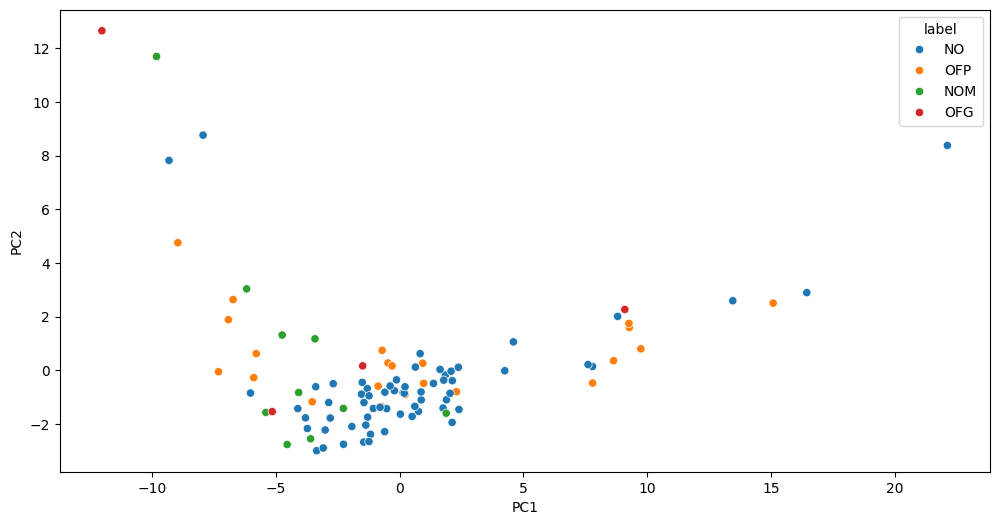

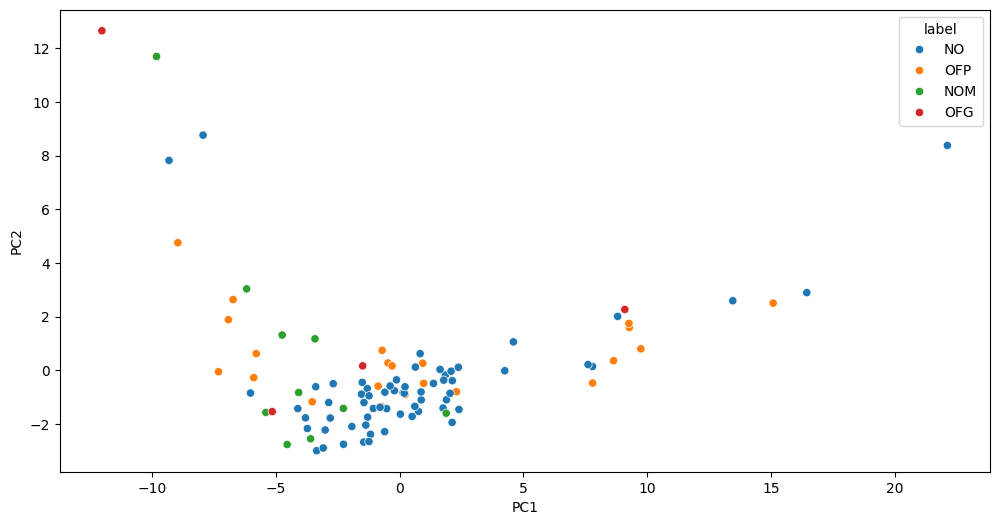

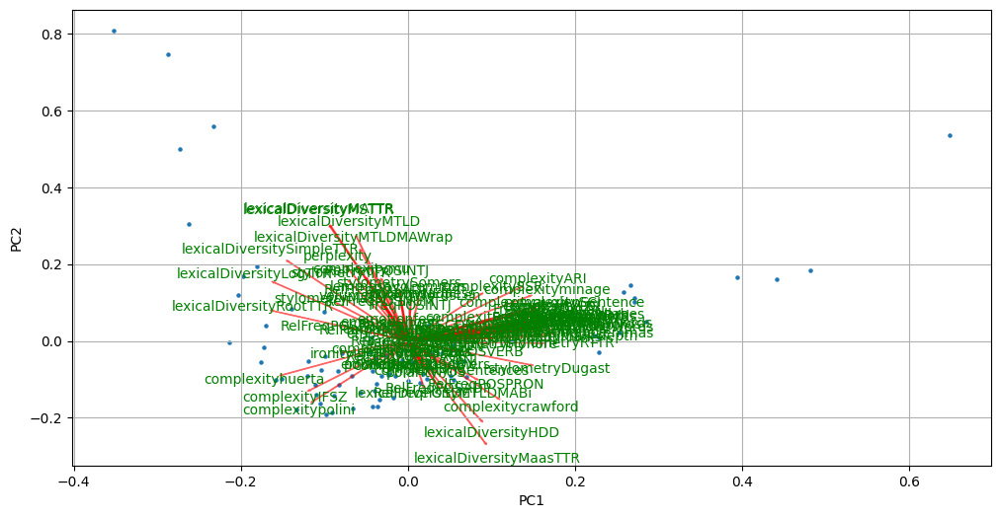

---------------------------- TSNE ----------------------------


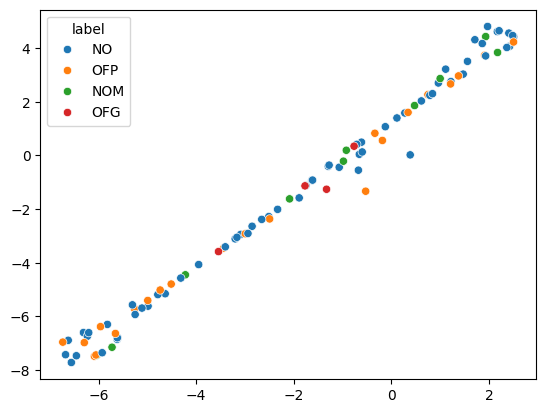

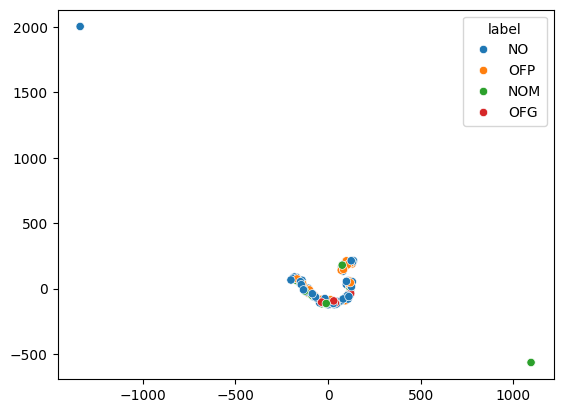

---------------------------- NNMF ----------------------------
error is 0.46
error is 0.43
error is 0.37
error is 0.36
error is 0.35
error is 0.35
error is 0.35
error is 0.35
error is 0.35
error is 0.35


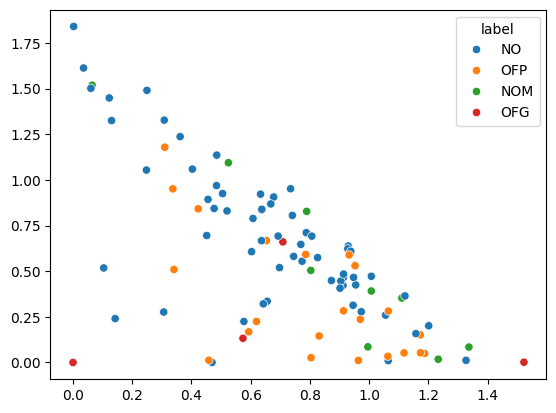

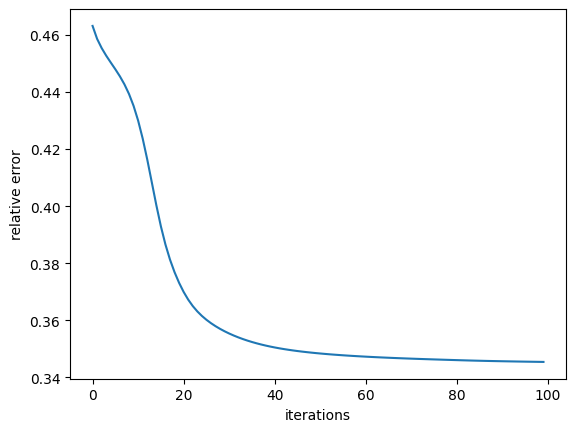

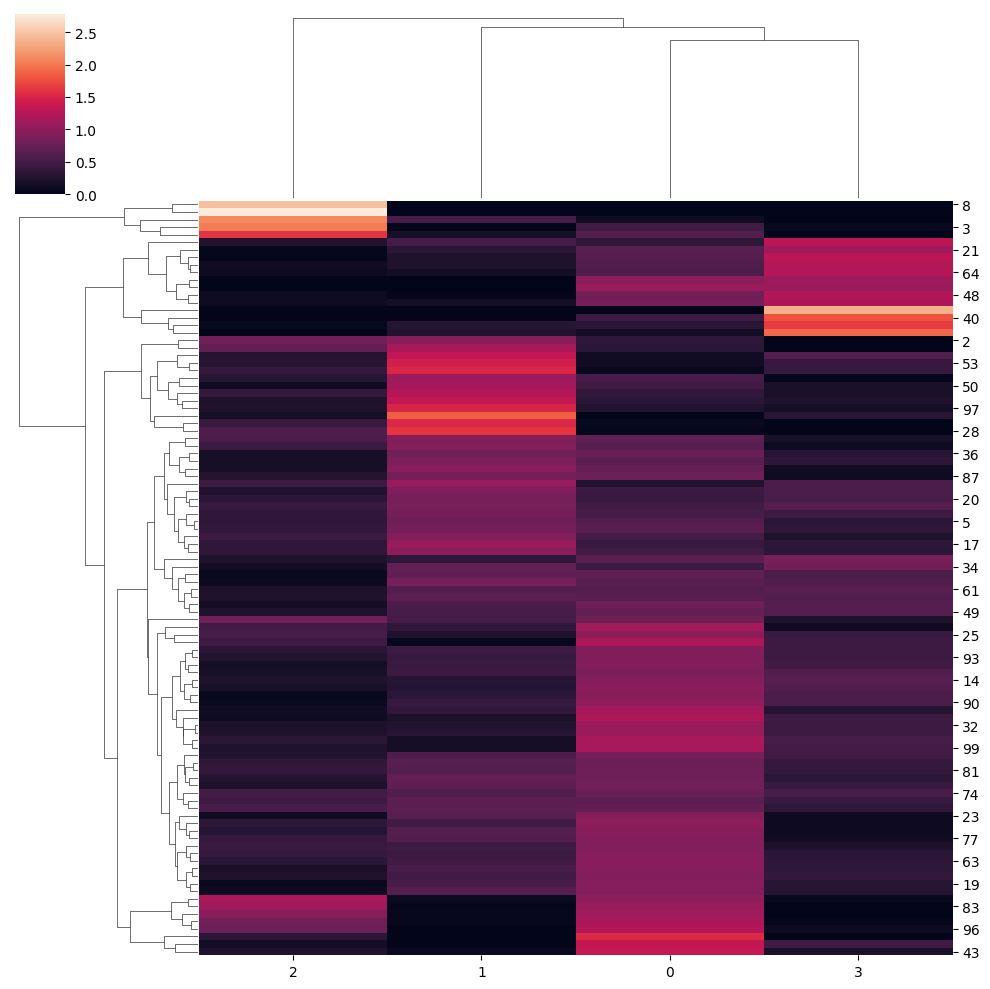

(array([[1.30126689e-01, 1.32505824e+00, 2.64523100e-01, 5.94117471e-01],
        [7.73643674e-01, 5.54693017e-01, 1.52261742e-01, 6.28571403e-01],
        [3.37229029e-01, 9.51238701e-01, 7.95465238e-01, 8.52076326e-07],
        [4.69618408e-01, 1.59142912e-04, 2.01259690e+00, 6.26861249e-02],
        [5.77111784e-01, 2.24735684e-01, 1.28763470e-01, 1.22674477e+00],
        [6.07882353e-01, 7.89057373e-01, 3.58134496e-01, 3.17972072e-01],
        [7.87878030e-01, 7.11118906e-01, 2.67432303e-01, 3.13124321e-01],
        [6.53273882e-01, 6.67275413e-01, 4.42208967e-01, 4.22975971e-01],
        [7.20113507e-04, 2.53016502e-04, 2.45592576e+00, 7.81237148e-05],
        [5.93630219e-01, 1.68019088e-01, 1.60250056e+00, 1.75480159e-05],
        [6.55702628e-01, 3.35378514e-01, 2.18143231e-01, 8.54632245e-01],
        [1.03696263e-01, 5.17813393e-01, 2.09908115e+00, 1.45867158e-04],
        [4.55928794e-01, 8.93627940e-01, 2.33496790e-01, 5.53333332e-01],
        [5.24694636e-01, 1.09420482e+0

In [ ]:
print('---------------------------- PCA ----------------------------')
# Apply the PCA visualization function without biplot.
v.show_pca(X, y, biplot= False, labelColumn= 'label')
# Apply the PCA visualization function with biplot.
v.show_pca(X, y, labelColumn= 'label')
print('---------------------------- TSNE ----------------------------')
# Apply the TSNE visualization function with default TSNE (tsne=TSNE(random_state = 0)).
v.show_tsne(X, label=y)
# Apply the TSNE visualization function with customized TSNE (tsne=TSNE(random_state = 0)).
v.show_tsne(X, tsne = TSNE(perplexity = 9, early_exaggeration = 11, learning_rate = 451, random_state = 0), label=y)
print('---------------------------- NNMF ----------------------------')
# Apply the NNMF visualization function.
v.show_nnmf(4, X, y, 100)